## Hatalmas ötletem van

Repült felém egy bogár és arar gondoltam, hogy ezt a térbeli nyomvonalat is lehetne becsülni. Ekkor ez nem egy felület, hanem egy vonal.

## ToDo

Implementálni azt, hogy az neurális háló setup-ját és coefficienseit írja ki majd olvassa be valamilyen adathalmazból, amelyben minden iteráció lépése tárolva van

Implementálni a neurális háló architechturájának megjelenítését és a súlyokat

Implementálni az Axis3D modul segítségével az interaktív 3D plottot

Implementálni ugyan ezt pontfelhővel - nem domporazati térképpel

## MLPRegressor 3D

Kétváltozós neurális háló

Korábbi munkámból lehet meríteni [github](https://github.com/JoDeMiro/FuzzyBevezetes/blob/main/Estimation_01.ipynb)

In [30]:
%%capture
!pip install watermark

%load_ext watermark

In [119]:
import random
import numpy as np

import matplotlib.pyplot as plt
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

from mpl_toolkits.mplot3d import Axes3D

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

import warnings
warnings.filterwarnings('ignore')

In [120]:
%watermark

Last updated: 2021-09-09T15:04:35.219435+00:00

Python implementation: CPython
Python version       : 3.7.11
IPython version      : 5.5.0

Compiler    : GCC 7.5.0
OS          : Linux
Release     : 5.4.104+
Machine     : x86_64
Processor   : x86_64
CPU cores   : 2
Architecture: 64bit



In [121]:
%watermark --iversions

plotly    : 4.4.1
matplotlib: 3.2.2
IPython   : 5.5.0
ipywidgets: 7.6.3
numpy     : 1.19.5
google    : 2.0.3



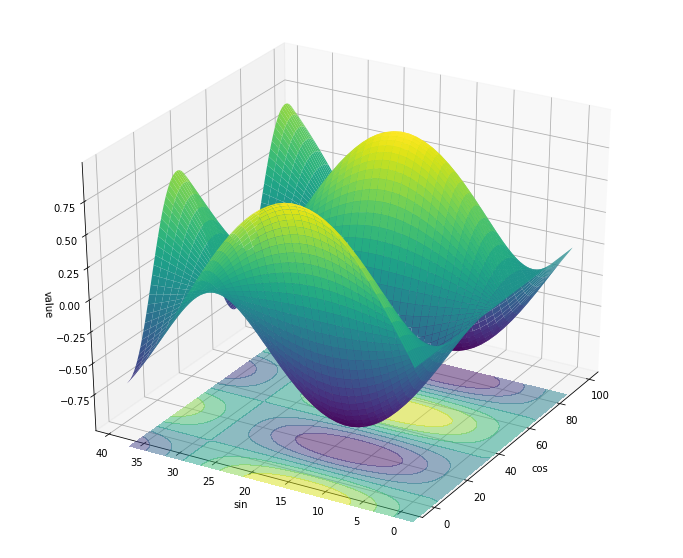

In [140]:

x1 = 40
x2 = 100

x1_space = np.linspace(0, x1-1, x1)
x2_space = np.linspace(0, x2-1, x2)

x1, x2 = np.meshgrid(x2_space, x1_space)
z = np.zeros_like(x1)

for i in range(len(x1_space)):
  i = int(i)
  for j in range(len(x2_space)):
    j = int(j)
    z[i, j] = np.sin(i/10)*np.cos(j/10)

# 3D plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlabel('cos')
ax.set_ylabel('sin')
ax.set_zlabel('value')
surf = ax.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.4, antialiased = True)
cset = ax.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
ax.view_init(30, 210)


In [123]:
# Ez mind szép és jó, de ezeket most három változóba kéne rendezni x1, x2, y

print(x1.shape)
print(x2.shape)
print(z.shape)

(40, 100)
(40, 100)
(40, 100)


In [124]:
x1[:3,:4]

array([[0., 1., 2., 3.],
       [0., 1., 2., 3.],
       [0., 1., 2., 3.]])

In [125]:
x2[:3,:4]

array([[0., 0., 0., 0.],
       [1., 1., 1., 1.],
       [2., 2., 2., 2.]])

In [126]:
z[:3,:4]

array([[0.        , 0.        , 0.        , 0.        ],
       [0.09983342, 0.09933467, 0.0978434 , 0.09537451],
       [0.19866933, 0.19767681, 0.19470917, 0.18979606]])

In [127]:
_x1 = x1.ravel()
_x2 = x2.ravel()
_z  = z.ravel()

In [128]:
X = np.array([_x1, _x2]).T

In [129]:
X.shape

(4000, 2)

In [130]:
_z.shape

(4000,)

In [131]:
x_scaler = MinMaxScaler(feature_range=(-1,1))
y_scaler = MinMaxScaler(feature_range=(-1,1))

x_scaler.fit(X)
y_scaler.fit(_z.reshape(-1, 1))

X_scaled = x_scaler.transform(X)
y_scaled = y_scaler.transform(_z.reshape(-1, 1))

print('X_scaled.max = ', X_scaled.max())
print('X_scaled.min = ', X_scaled.min())
print('y_scaled.max = ', y_scaled.max())
print('y_scaled.min = ', y_scaled.min())

X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0


In [132]:
mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                   activation='tanh',              # tanh, logistic, relu
                   solver='sgd',                   # adam, sgd, lbfgs
                   batch_size='auto',              # Fontos 'auto', 200, 1, _z.size
                   learning_rate_init=0.01,        # Fontos 0.01, 0.02, 0.05, 0.1
                   max_iter=1000,                  # Fontos
                   shuffle=True,                   # Fontos
                   random_state=1,
                   warm_start=False,               # Fontos
                   momentum=0.9,
                   nesterovs_momentum=False,
                   early_stopping=True,            # Fontos
                   verbose=0,
                   n_iter_no_change=1000)


In [133]:
mlp.fit(X_scaled, y_scaled)

predicted_scaled = mlp.predict(X_scaled)

r2 = r2_score(y_scaled, predicted_scaled)

print('r2 = {:.2f}'.format(r2))

r2 = 0.98


In [134]:
predicted_inverted = y_scaler.inverse_transform(predicted_scaled.reshape(-1, 1))

r2 = r2_score(_z, predicted_inverted)

print('r2 = {:.2f}'.format(r2))

r2 = 0.98


In [135]:
# a predicted változót vissza kell alakítani mátrix formába

predicted_z = predicted_inverted.reshape(z.shape[0], z.shape[1])

print(predicted_z.shape)

(40, 100)


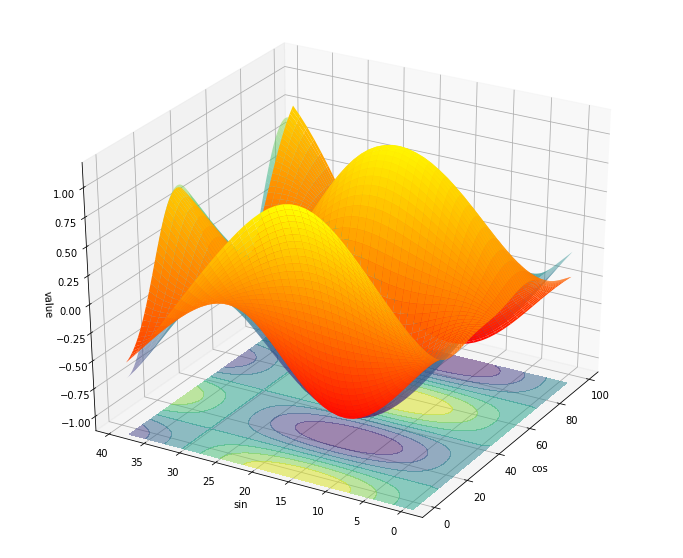

In [136]:
# 3D plot

def Plot4D(x1, x2, z, z_predicted):
  fig = plt.figure(figsize=(12, 10))
  ax = fig.add_subplot(111, projection='3d')
  ax.set_xlabel('cos')
  ax.set_ylabel('sin')
  ax.set_zlabel('value')
  surf = ax.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
  surf = ax.plot_surface(x1, x2, z_predicted, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
  cset = ax.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
  ax.view_init(30, 210)

Plot4D(x1, x2, z, predicted_z)

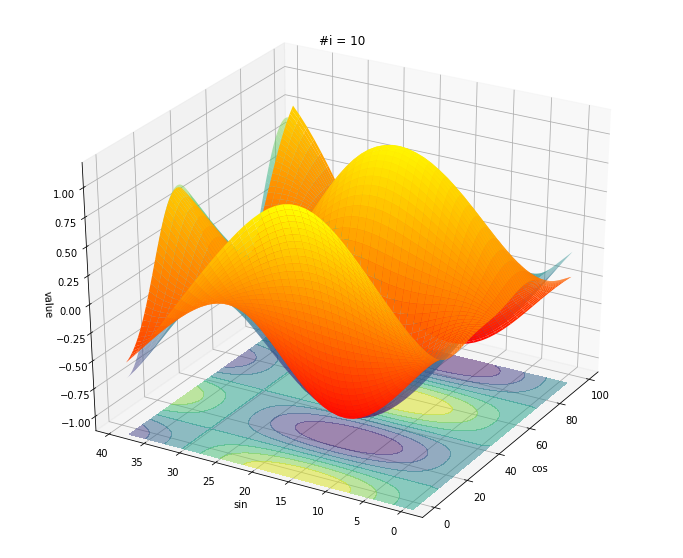

In [137]:
# 3D plot

def Save4D(x1, x2, z, z_predicted, i, rotate):
  fig = plt.figure(figsize=(12, 10))
  ax = fig.add_subplot(111, projection='3d')
  ax.set_xlabel('cos')
  ax.set_ylabel('sin')
  ax.set_zlabel('value')
  ax.set_title('#i = ' + str(i))
  surf = ax.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
  surf = ax.plot_surface(x1, x2, z_predicted, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
  cset = ax.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
  ax.view_init(30, rotate)
  fig.savefig('3D{0:03}'.format(i)+'.png')
  plt.show()
  plt.close()

Save4D(x1, x2, z, predicted_z, 10, 210)

## Rohadt lassú

Mérjük már ki, hogy másik matplotlib backenddel nem gyorsabb-e

Tanulság az, hogy hiába a backend csere az egész Matplotlib koncepció lassú



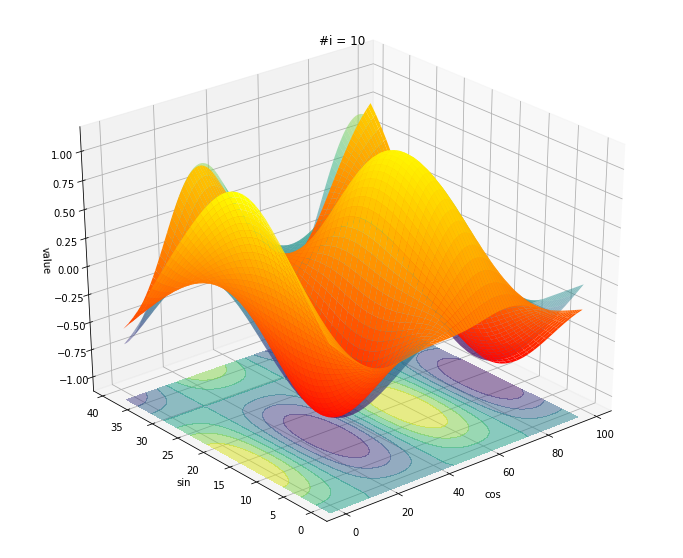

CPU times: user 1.66 s, sys: 156 ms, total: 1.81 s
Wall time: 1.67 s


In [106]:
%%time
Save4D(x1, x2, z, predicted_z, 10, 230)

In [107]:
# %prun Save4D(x1, x2, z, predicted_z, 10, 230)

## Matplotlib irdatlan lassú

Próbáljuk meg egy másik vizualizációs könyvtárral

In [52]:
import plotly.graph_objects as go

In [58]:
z1 = z
z2 = predicted_z

fig = go.Figure(data=[
    go.Surface(z=z1, showscale=False, opacity=0.9),
    go.Surface(z=z2, showscale=False, opacity=0.9)
])

fig.show()

In [54]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [108]:
# Initialize figure with 2 3D subplots

fig = make_subplots(
    rows=1, cols=2,
    specs=[[{'type': 'surface'}, {'type': 'surface'}]])

# Generate data
x_ = x1
y_ = x2
z1 = z
z2 = predicted_z

# adding surfaces to subplots.
fig.add_trace(
    go.Surface(x=x_, y=y_, z=z1, colorscale='Viridis', showscale=False),
    row=1, col=1)

fig.add_trace(
    go.Surface(x=x_, y=y_, z=z2, colorscale='RdBu', showscale=False),
    row=1, col=2)

fig.update_layout(
    title_text='3D subplots with different colorscales',
    height=400,
    width=800
)

fig.show()

## Export png

https://plotly.com/python/static-image-export/

In [59]:
%%capture
!wget https://github.com/plotly/orca/releases/download/v1.2.1/orca-1.2.1-x86_64.AppImage -O /usr/local/bin/orca
!chmod +x /usr/local/bin/orca
!apt-get install xvfb libgtk2.0-0 libgconf-2-4

In [109]:

fig.write_image('plotty.png')


## Download files

In [64]:
from google.colab import files

files.download('plotty.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Egy plotly verzió

In [110]:
z1 = z
z2 = predicted_z

fig = go.Figure(data=[
    go.Surface(z=z1, colorscale='Viridis', showscale=False, opacity=0.5),
    go.Surface(z=z2, colorscale='RdBu', showscale=False, opacity=0.5)
])

fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))

fig.update_layout(
    title='3D subplots with different colorscales',
    autosize=False,
    scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
    width=800,
    height=800,
    margin=dict(l=65, r=50, b=65, t=90)
)

fig.show()

fig.write_image('plotty.png')

files.download('plotty.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Interaktiv 3D

## Egy konkrét tanítás interkatív megjelenítése

In [111]:
# 3D plot

def Plot4D(x1, x2, z, z_predicted, rotate):
  fig = plt.figure(figsize=(12, 10))
  ax = fig.add_subplot(111, projection='3d')
  ax.set_xlabel('cos')
  ax.set_ylabel('sin')
  ax.set_zlabel('value')
  surf = ax.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
  surf = ax.plot_surface(x1, x2, z_predicted, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
  cset = ax.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
  ax.view_init(30, rotate)
  plt.show()

In [112]:
interact(Plot4D, x1 = fixed(x1), x2 = fixed(x2), z = fixed(z), z_predicted = fixed(predicted_z), rotate = widgets.IntSlider(min=180, max=270, step=1, value=220));

interactive(children=(IntSlider(value=220, description='rotate', max=270, min=180), Output()), _dom_classes=('…

## Create gif function

In [ ]:
from PIL import Image
import glob

def create_gif(duration):

  frames = []
  imgs = glob.glob("*.png")
  imgs.sort()
  for i in imgs:
      new_frame = Image.open(i)
      frames.append(new_frame)

  frames[0].save('animation.gif', format='GIF',
                append_images=frames[1:],
                save_all=True,
                duration=duration, loop=0)

In [ ]:
create_gif(100)

## Sequential Animation - Batch Learning

rm: cannot remove '*.gif': No such file or directory
#i =  1
r2 = -0.45


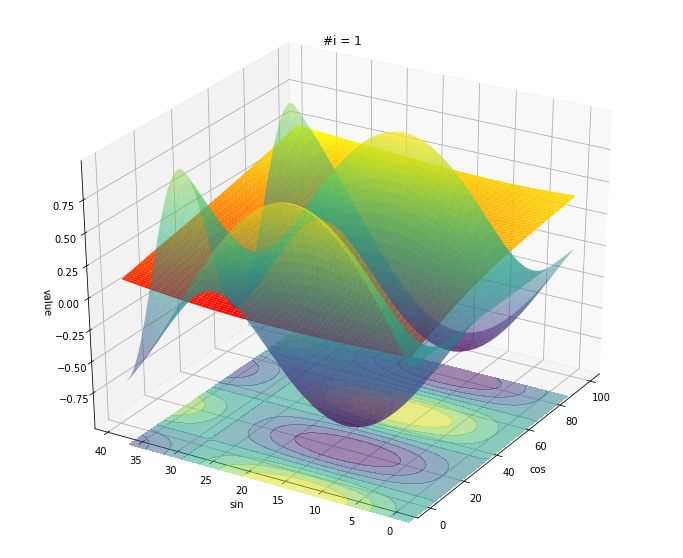

#i =  51
r2 = 0.02


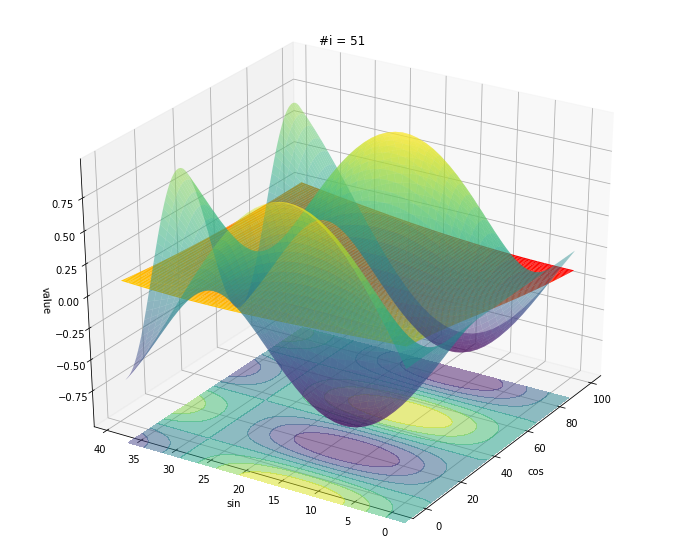

#i =  101
r2 = 0.03


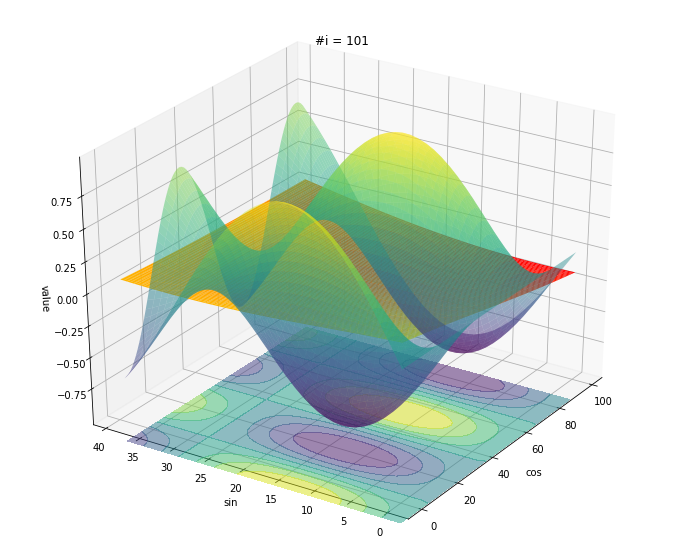

#i =  151
r2 = 0.03


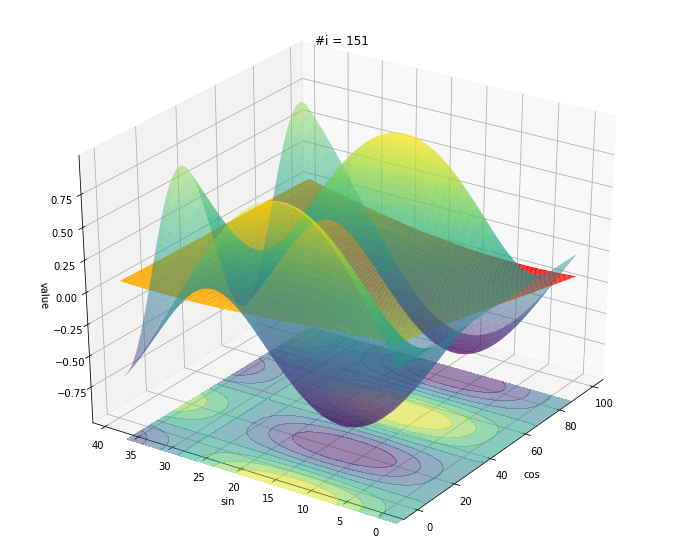

#i =  201
r2 = 0.05


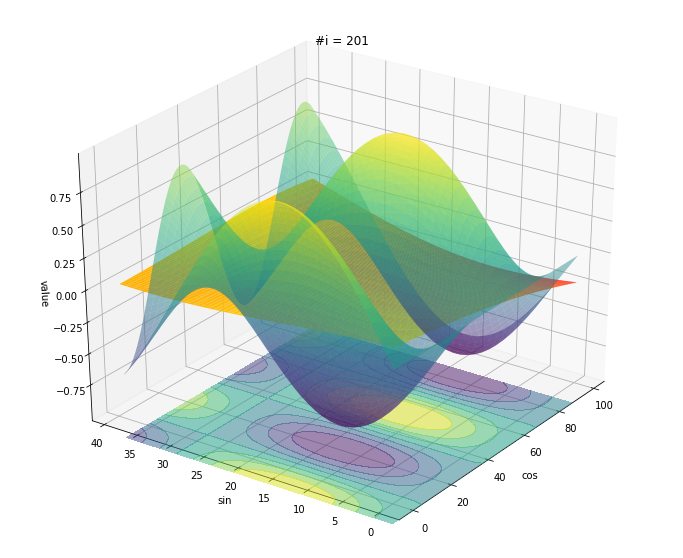

#i =  251
r2 = 0.21


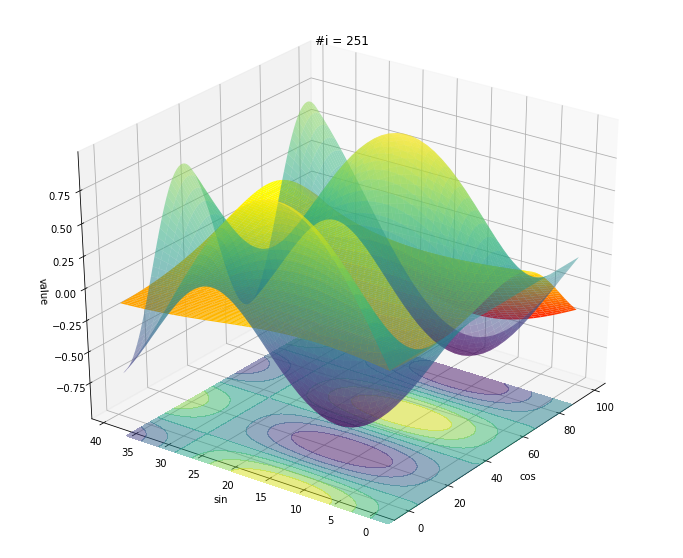

#i =  301
r2 = 0.72


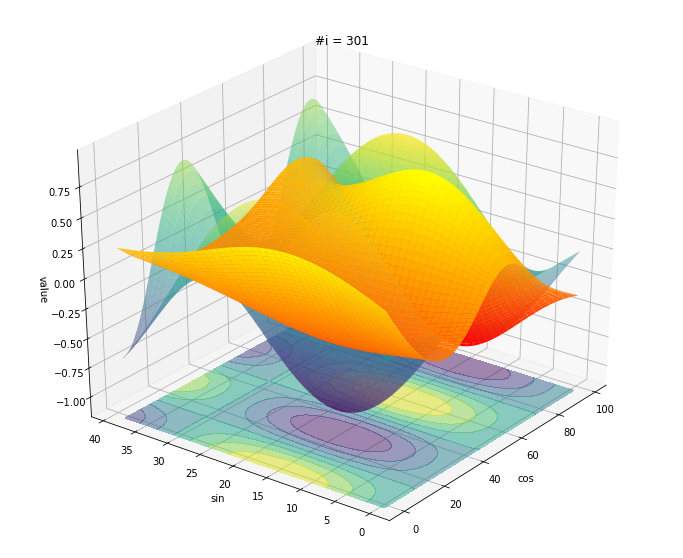

#i =  351
r2 = 0.89


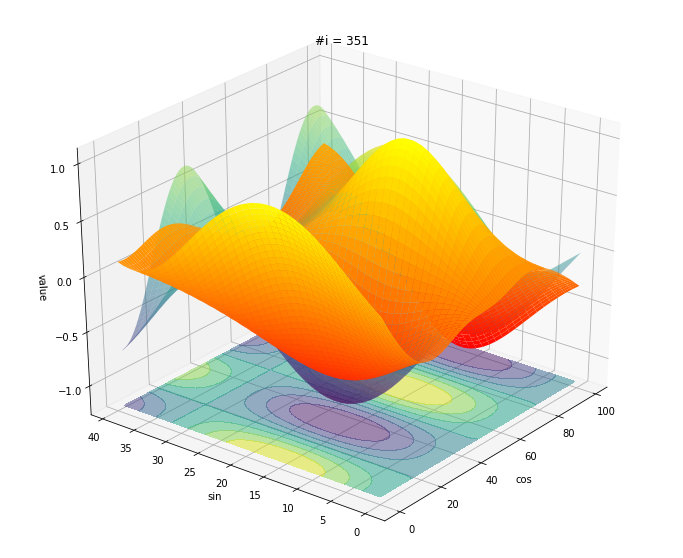

#i =  401
r2 = 0.93


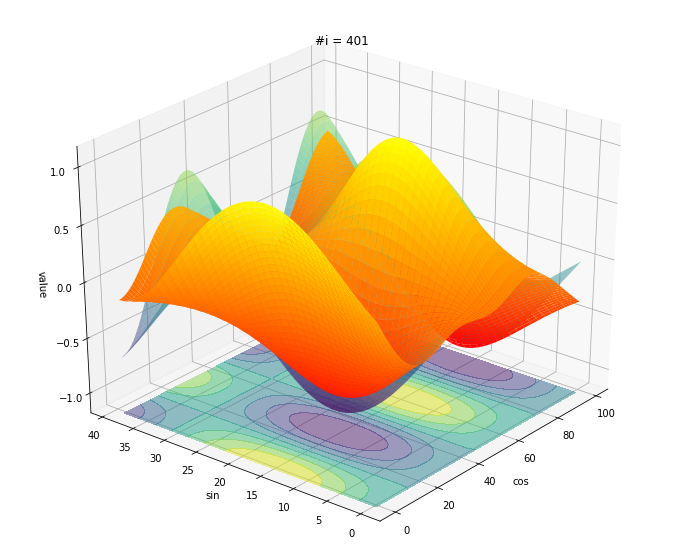

#i =  451
r2 = 0.94


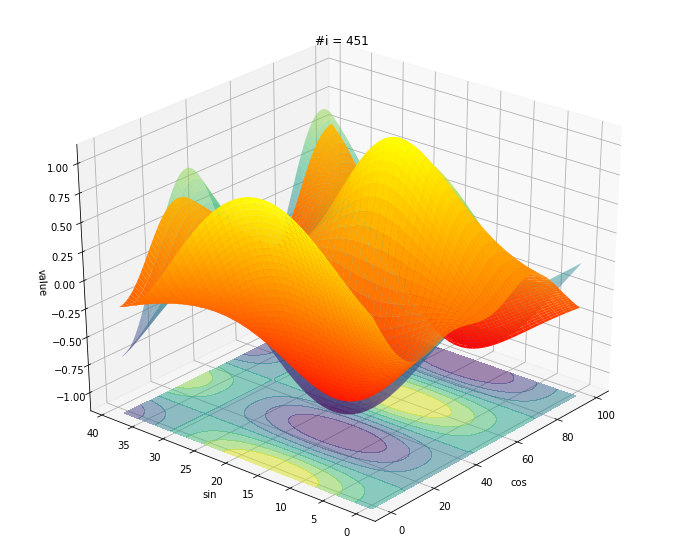

#i =  501
r2 = 0.95


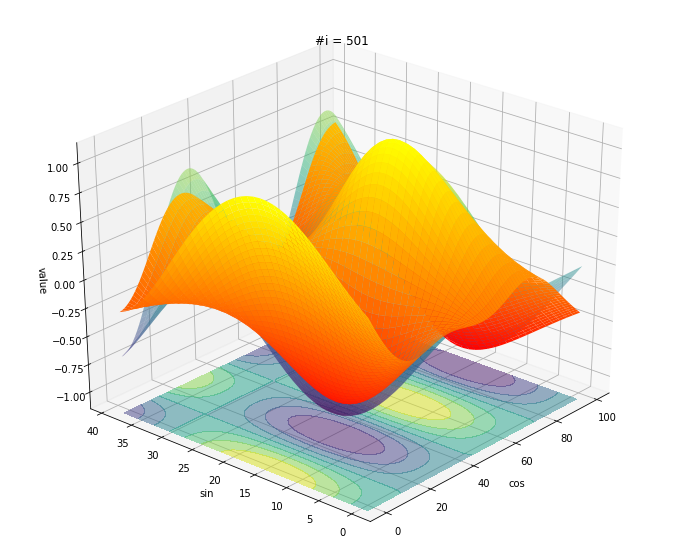

#i =  551
r2 = 0.95


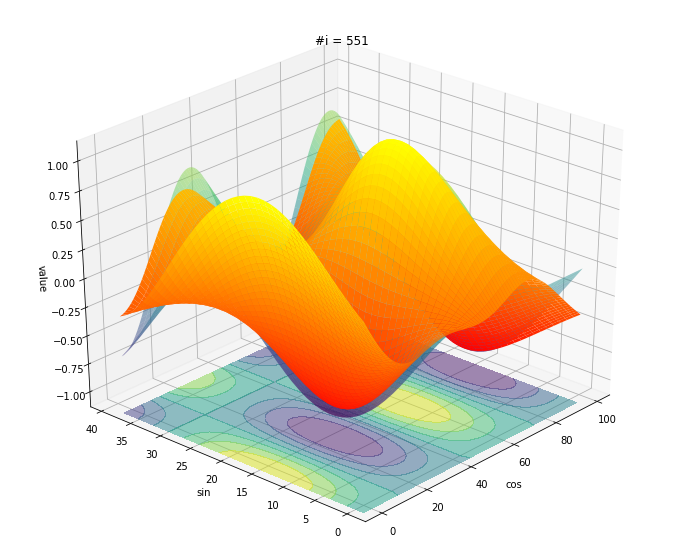

#i =  601
r2 = 0.96


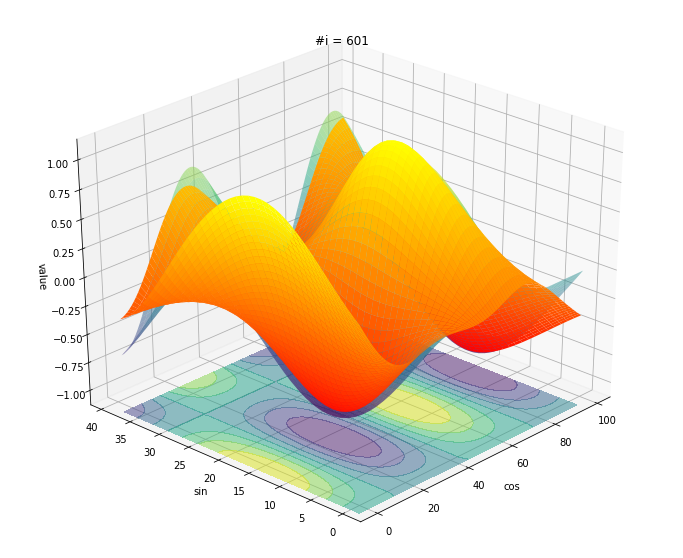

#i =  651
r2 = 0.96


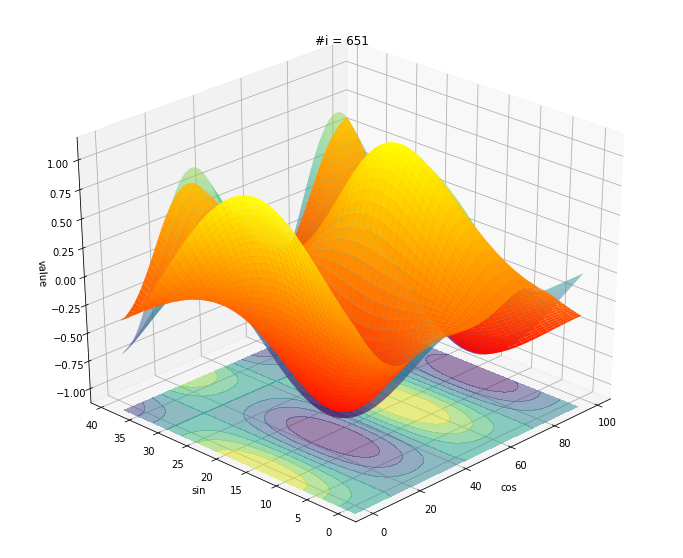

#i =  701
r2 = 0.97


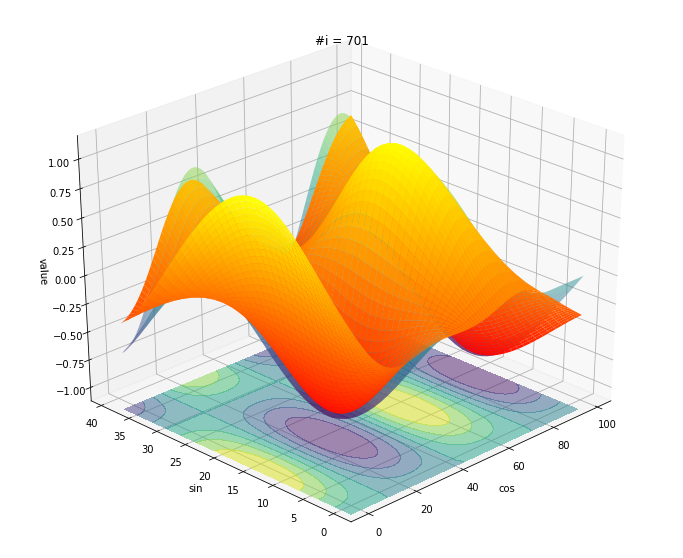

#i =  751
r2 = 0.97


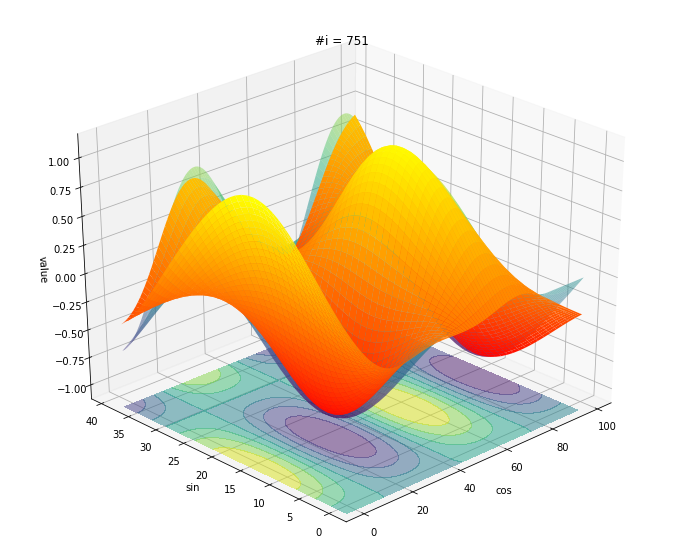

#i =  801
r2 = 0.97


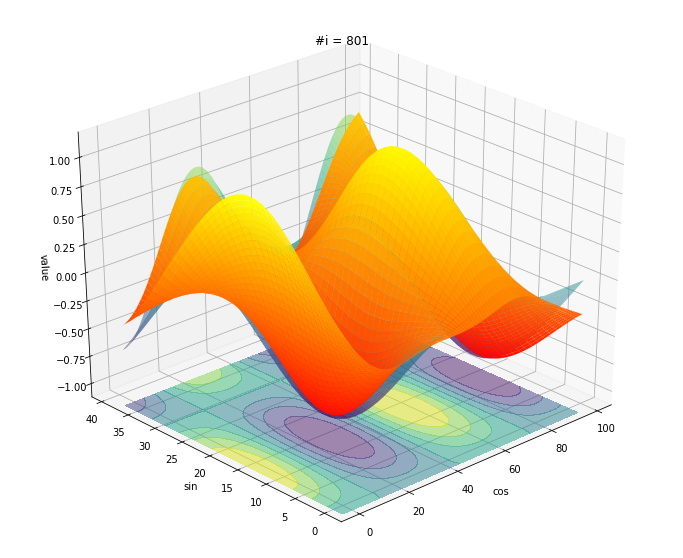

#i =  851
r2 = 0.98


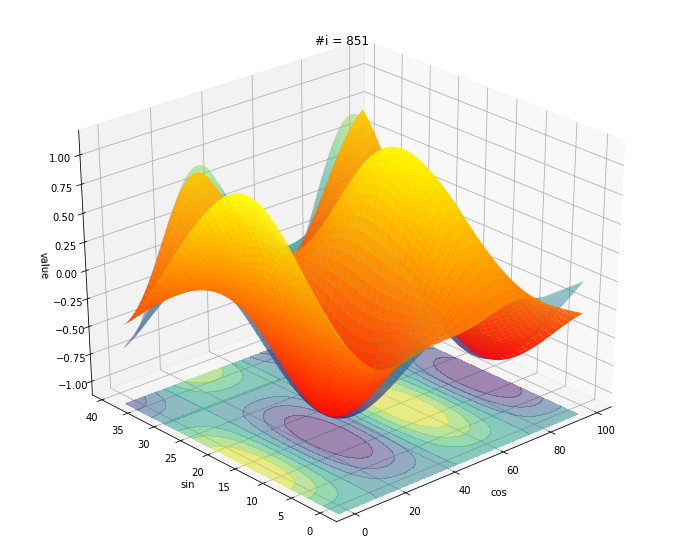

#i =  901
r2 = 0.98


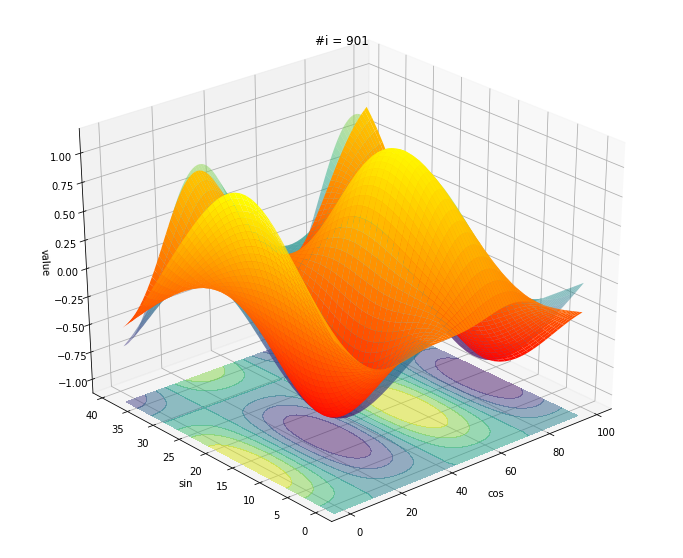

#i =  951
r2 = 0.98


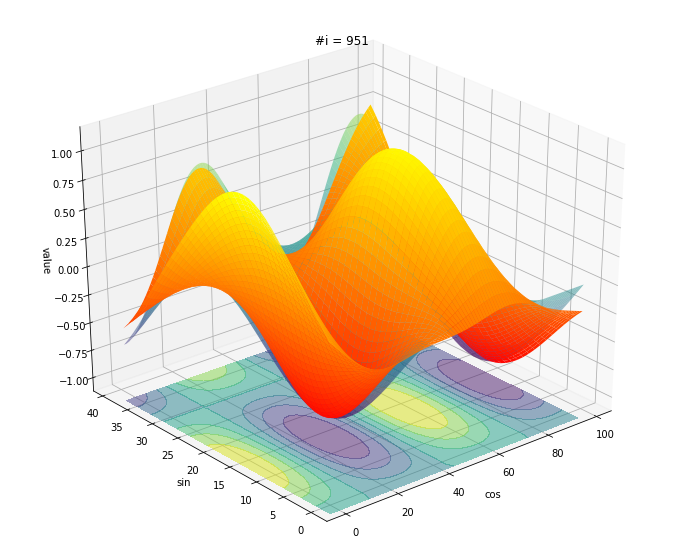

In [113]:
!rm *.png
!rm *.gif

counter = 0
for i in range (1, 1000, 50):
  counter += 1
  print('#i = ', i)
  mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                    activation='tanh',              # tanh, logistic, relu
                    solver='sgd',                   # adam, sgd, lbfgs
                    batch_size='auto',              # Fontos 'auto', 200, 1, _z.size
                    learning_rate_init=0.01,        # Fontos 0.01, 0.02, 0.05, 0.1
                    max_iter=i,                     # Fontos
                    shuffle=True,                   # Fontos
                    random_state=1,
                    warm_start=False,               # Fontos
                    momentum=0.9,
                    nesterovs_momentum=False,
                    early_stopping=True,            # Fontos
                    verbose=0,
                    n_iter_no_change=i+1)


  mlp.fit(X_scaled, y_scaled)

  predicted_scaled = mlp.predict(X_scaled)

  predicted_inverted = y_scaler.inverse_transform(predicted_scaled.reshape(-1, 1))

  r2 = r2_score(_z, predicted_inverted)

  print('r2 = {:.2f}'.format(r2))

  # a predicted változót vissza kell alakítani mátrix formába

  predicted_z = predicted_inverted.reshape(z.shape[0], z.shape[1])

  Save4D(x1, x2, z, predicted_z, i, 210 + counter)


## Próbáljuk meg interaktívvá tenni az egészet

In [115]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, 5, 0.1):
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="#00CED1", width=6),
            name="𝜈 = " + str(step),
            x=np.arange(0, 10, 0.01),
            y=np.sin(step * np.arange(0, 10, 0.01))))

# Make 10th trace visible
fig.data[10].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=10,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()

In [116]:
import plotly.graph_objects as go
import numpy as np

# Create scalers
scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one = MinMaxScaler(feature_range=(-1,1))

# Create MLPRegresor
mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                  activation='tanh',              # tanh, logistic, relu
                  solver='sgd',                   # adam, sgd, lbfgs
                  batch_size='auto',
                  learning_rate_init=0.1,         # Fontos 0.01, 0.02, 0.05, 0.1
                  max_iter=1,                     # Fontos
                  shuffle=False,                  # Fontos
                  random_state=1,
                  warm_start=True,                # Fontos ?
                  momentum=0.9,
                  nesterovs_momentum=False,
                  early_stopping=False,           # Fontos ?
                  verbose=1,
                  n_iter_no_change=1000)

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(2, 50, 1):









  
    fig.add_trace(
        go.Surface(visible=False,
                   z=z2,
                   name="𝜈 = " + str(step),
                   colorscale='RdBu',
                   showscale=False,
                   opacity=0.7)
        )

# Make 10th trace visible
fig.data[10].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=10,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()

In [85]:
# Amiket itt paraméterként végig lehet próbálni

# Átvilteli függvény (RELU, TANH, LOGISTIC)
# Optimizer (ADAM, SGD, LBSQRT)
# Learning Rate

# És természetesen az alap dilemma, ONLINE, BATCH

## Ez így rossz Warm_start (False, True)

Mert a for cikluson belül példányosítom az ``` MLPRegressor ``` ezért nem is működik.



In [149]:
x_scaled.shape

(4000, 2)

In [150]:
y_scaled.shape

(4000, 1)

X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
#i =  0
#i =  50
r2_1 = 0.03
r2_2 = 0.46
r2_1 = 0.03
r2_2 = 0.46


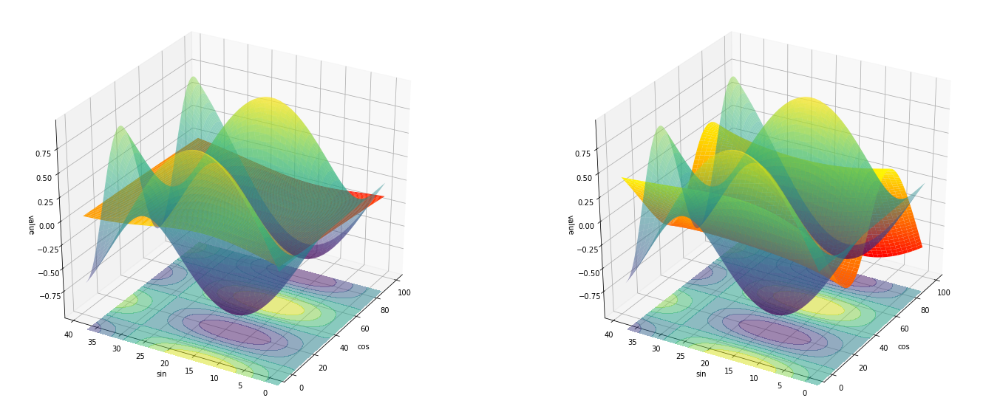

#i =  100
r2_1 = 0.22
r2_2 = 0.85
r2_1 = 0.22
r2_2 = 0.85


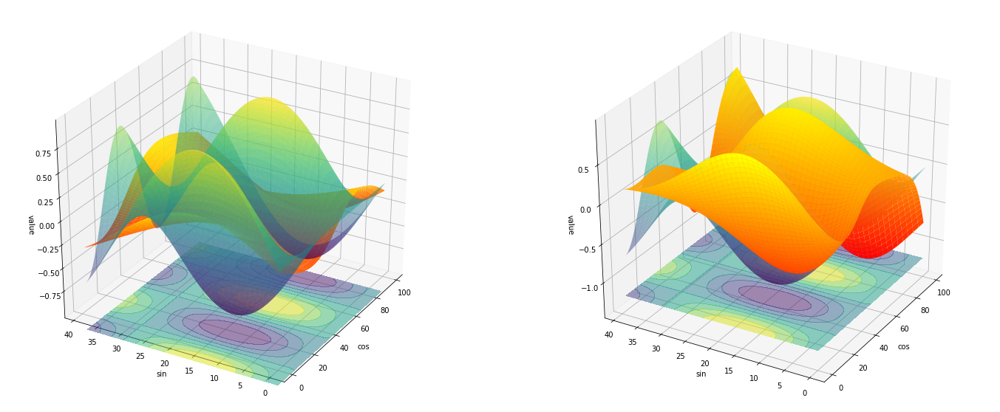

#i =  150
r2_1 = 0.47
r2_2 = 0.93
r2_1 = 0.47
r2_2 = 0.93


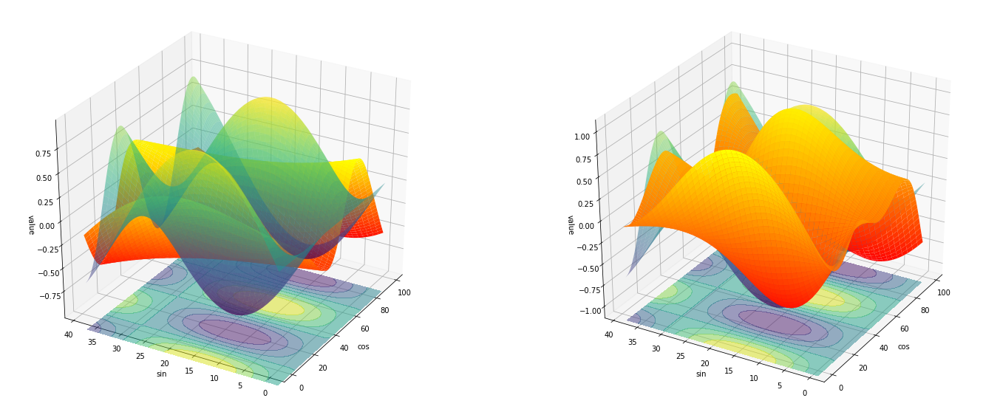

#i =  200
r2_1 = 0.48
r2_2 = 0.94
r2_1 = 0.48
r2_2 = 0.94


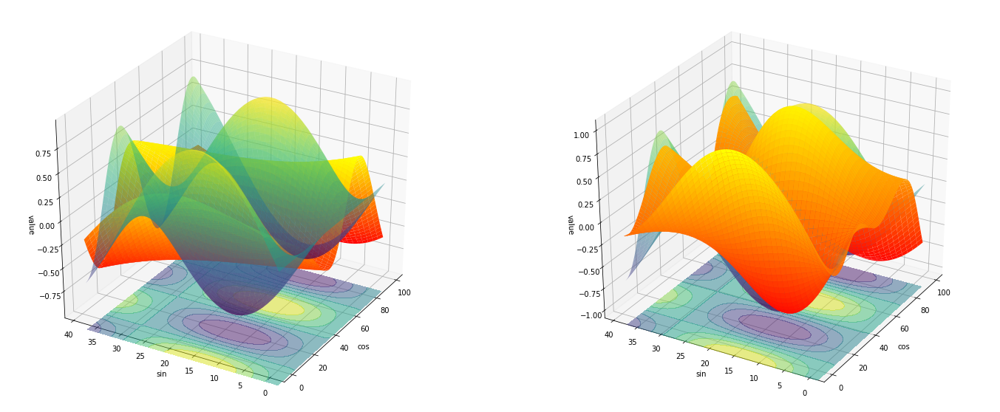

#i =  250
r2_1 = 0.48
r2_2 = 0.96
r2_1 = 0.48
r2_2 = 0.96


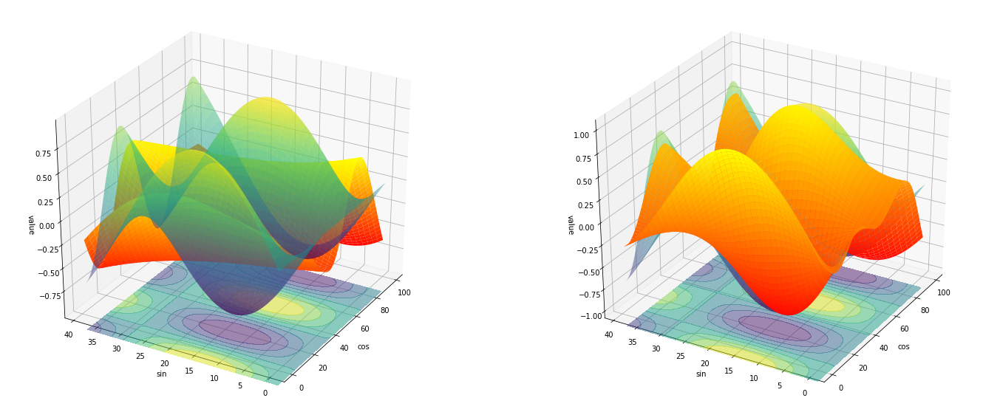

In [166]:
x_scaler = MinMaxScaler(feature_range=(-1,1))
y_scaler = MinMaxScaler(feature_range=(-1,1))

x_scaler.fit(X)
y_scaler.fit(_z.reshape(-1, 1))

X_scaled = x_scaler.transform(X)
y_scaled = y_scaler.transform(_z.reshape(-1, 1))

print('X_scaled.max = ', X_scaled.max())
print('X_scaled.min = ', X_scaled.min())
print('y_scaled.max = ', y_scaled.max())
print('y_scaled.min = ', y_scaled.min())


for i in range(0, 300, 50):
  print('#i = ', i)
  if( i != 0 ):
    mlp1 = MLPRegressor(hidden_layer_sizes=(3, ),           # itt van különbség
                      activation='tanh',
                      solver='sgd',
                      batch_size='auto',
                      learning_rate_init=0.05,
                      max_iter=i,
                      shuffle=False,
                      random_state=1,
                      warm_start=False,                     # False
                      momentum=0.9,
                      nesterovs_momentum=True,
                      early_stopping=True,
                      n_iter_no_change=2000)
    
    mlp2 = MLPRegressor(hidden_layer_sizes=(10, ),          # itt van különbség
                      activation='tanh',
                      solver='sgd',
                      batch_size='auto',
                      learning_rate_init=0.05,
                      max_iter=i,
                      shuffle=False,
                      random_state=1,
                      warm_start=True,                      # True
                      momentum=0.9,
                      nesterovs_momentum=True,
                      early_stopping=True,
                      n_iter_no_change=2000)
    

    mlp1.fit(X_scaled, y_scaled)
    predicted_scaled_1 = mlp1.predict(X_scaled)
    r2_1 = r2_score(y_scaled, predicted_scaled_1)
    print('r2_1 = {:.2f}'.format(r2_1))

    mlp2.fit(X_scaled, y_scaled)
    predicted_scaled_2 = mlp2.predict(X_scaled)
    r2_2 = r2_score(y_scaled, predicted_scaled_2)
    print('r2_2 = {:.2f}'.format(r2_2))

    predicted_inverted_1 = y_scaler.inverse_transform(predicted_scaled_1.reshape(-1, 1))
    r2_1 = r2_score(_z, predicted_inverted_1)
    print('r2_1 = {:.2f}'.format(r2_1))

    predicted_inverted_2 = y_scaler.inverse_transform(predicted_scaled_2.reshape(-1, 1))
    r2_2 = r2_score(_z, predicted_inverted_2)
    print('r2_2 = {:.2f}'.format(r2_2))

    # a predicted változót vissza kell alakítani mátrix formába
    predicted_z_1 = predicted_inverted_1.reshape(z.shape[0], z.shape[1])
    # print(predicted_z_1.shape)

    # a predicted változót vissza kell alakítani mátrix formába
    predicted_z_2 = predicted_inverted_2.reshape(z.shape[0], z.shape[1])
    # print(predicted_z_2.shape)


    fig = plt.figure(figsize=(24, 10))
    ax1 = fig.add_subplot(121, projection='3d')
    ax1.set_xlabel('cos')
    ax1.set_ylabel('sin')
    ax1.set_zlabel('value')
    surf = ax1.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
    surf = ax1.plot_surface(x1, x2, predicted_z_1, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
    cset = ax1.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
    ax1.view_init(30, 210)

    ax2 = fig.add_subplot(122, projection='3d')
    ax2.set_xlabel('cos')
    ax2.set_ylabel('sin')
    ax2.set_zlabel('value')
    surf = ax2.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
    surf = ax2.plot_surface(x1, x2, predicted_z_2, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
    cset = ax2.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
    ax2.view_init(30, 210)
    plt.show()



## Ez így jó Warm_start (False, True)

Mert a for cikluson kívűl példányosítom az ``` MLPRegressor ```

## (!)

Azonban vigyázni kell mert csalóka az $online$ és a $batch$ összehasonlítása, ha a ciklus lépésköze nem egy. Ugyanis az online minden ciklusban csak egyszer tanul a bach viszont megkapja értékként, hogy hány iterációt hajtson végre.



```
# for i in range(0, 100, 5):
```

esetében az online valójában csask 20 iterációt hajt végre, a batch viszont ténylegesen 100-at.



X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
#i =  0
#i =  1
r2_online = 0.01
r2_batch = 0.01
r2_online = 0.01
r2_batch = 0.01


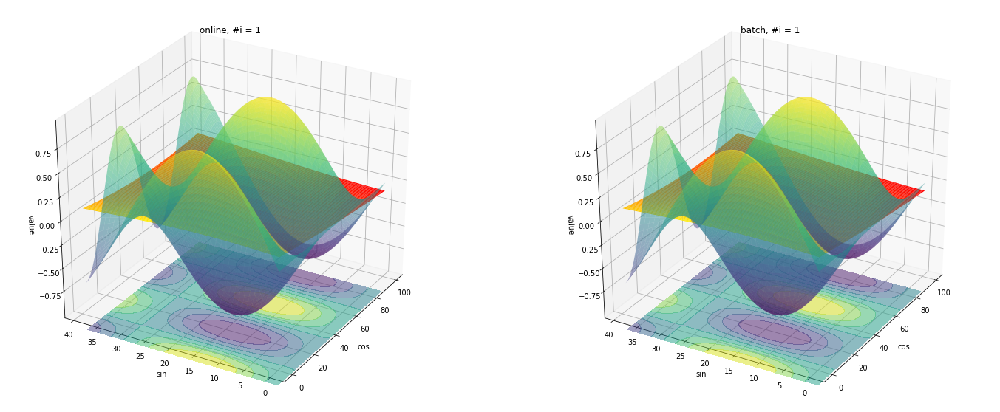

#i =  2
r2_online = 0.02
r2_batch = 0.02
r2_online = 0.02
r2_batch = 0.02


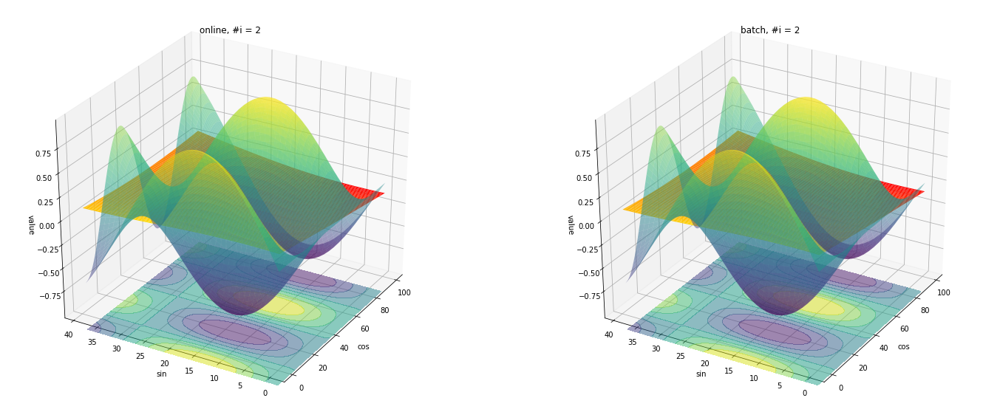

#i =  3
r2_online = 0.02
r2_batch = 0.02
r2_online = 0.02
r2_batch = 0.02


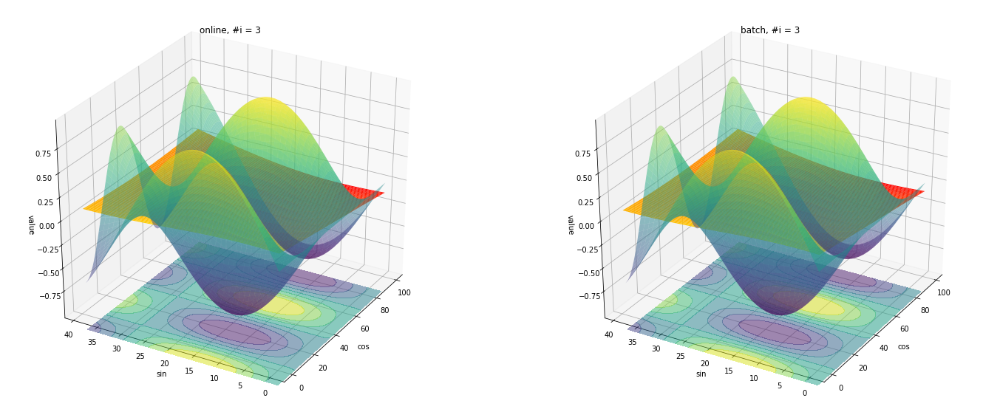

#i =  4
r2_online = 0.03
r2_batch = 0.03
r2_online = 0.03
r2_batch = 0.03


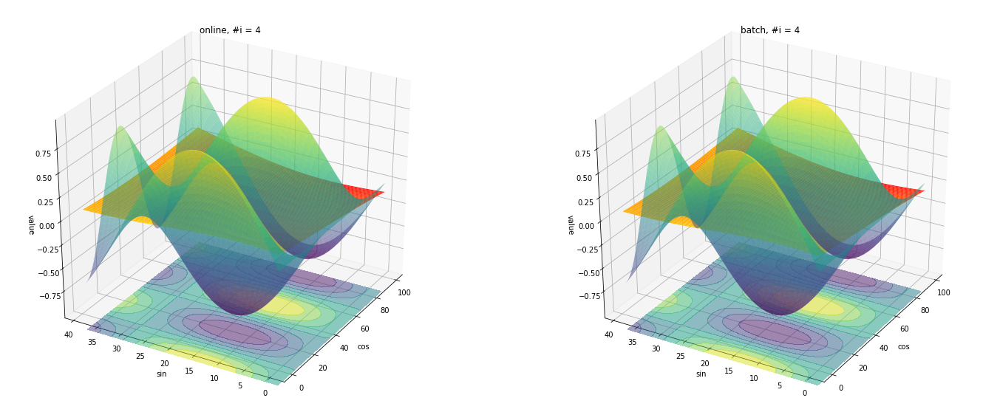

#i =  5
r2_online = 0.03
r2_batch = 0.04
r2_online = 0.03
r2_batch = 0.04


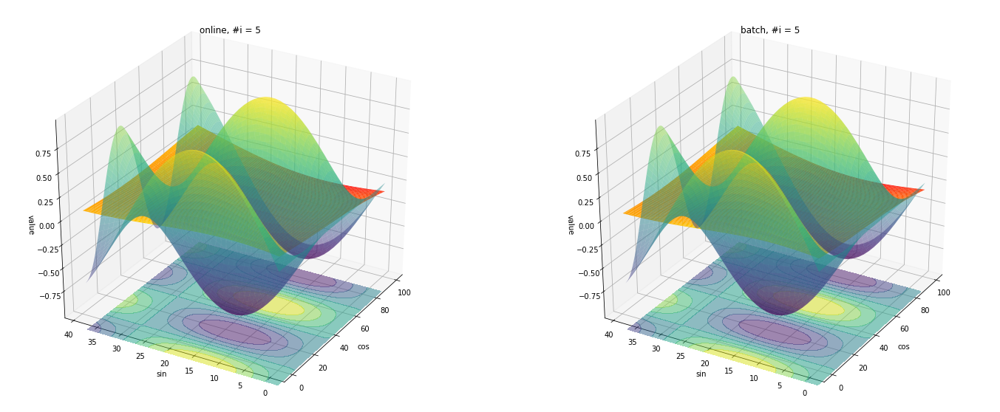

#i =  6
r2_online = 0.07
r2_batch = 0.08
r2_online = 0.07
r2_batch = 0.08


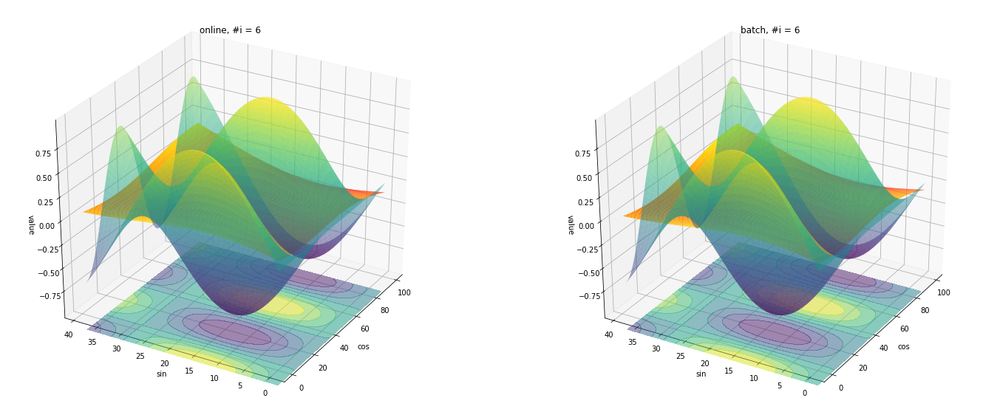

#i =  7
r2_online = 0.19
r2_batch = 0.23
r2_online = 0.19
r2_batch = 0.23


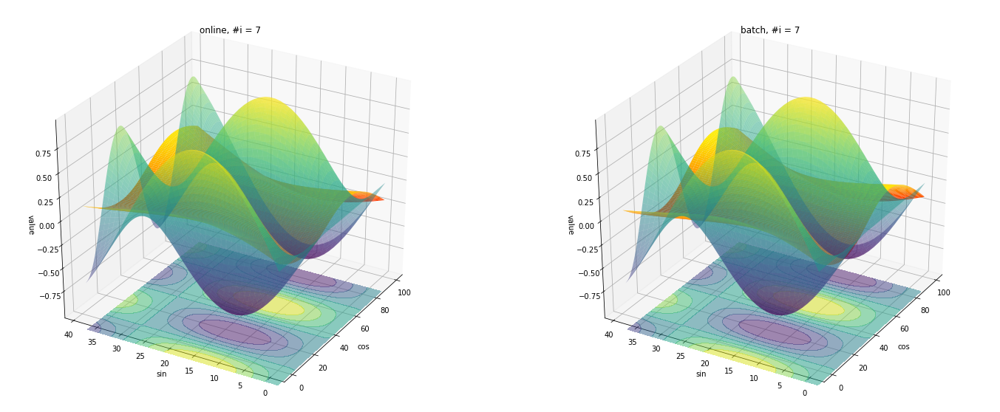

#i =  8
r2_online = 0.37
r2_batch = 0.38
r2_online = 0.37
r2_batch = 0.38


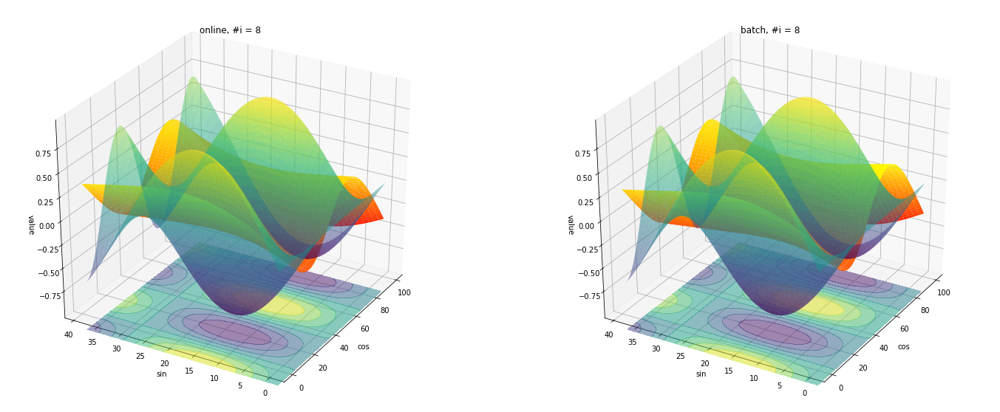

#i =  9
r2_online = 0.42
r2_batch = 0.42
r2_online = 0.42
r2_batch = 0.42


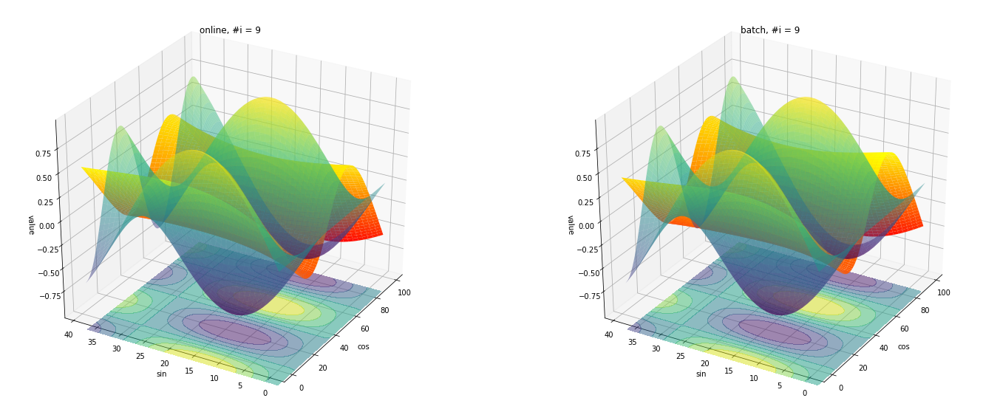

#i =  10
r2_online = 0.45
r2_batch = 0.45
r2_online = 0.45
r2_batch = 0.45


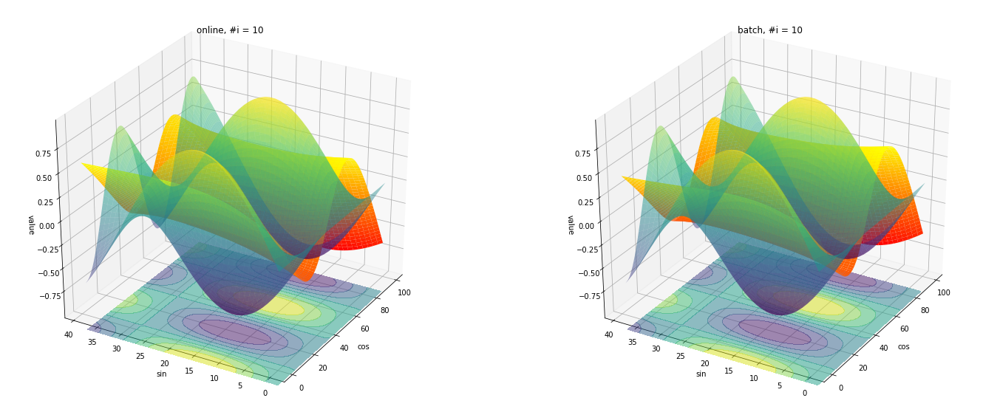

#i =  11
r2_online = 0.47
r2_batch = 0.49
r2_online = 0.47
r2_batch = 0.49


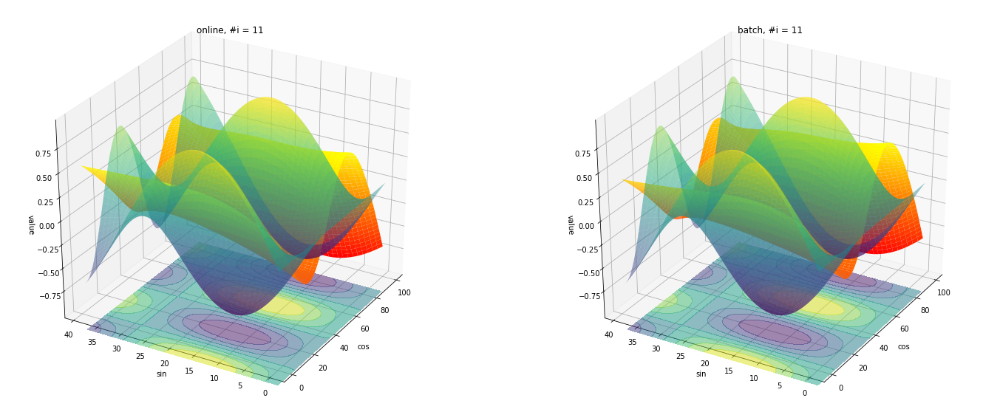

#i =  12
r2_online = 0.51
r2_batch = 0.53
r2_online = 0.51
r2_batch = 0.53


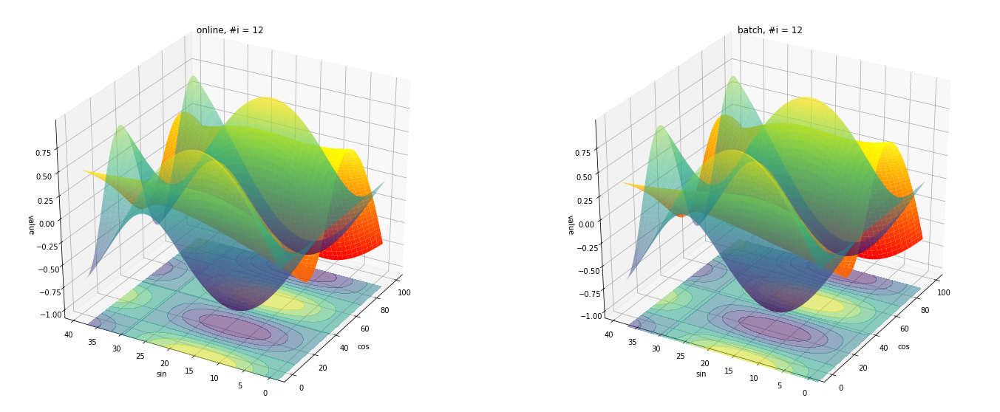

#i =  13
r2_online = 0.55
r2_batch = 0.58
r2_online = 0.55
r2_batch = 0.58


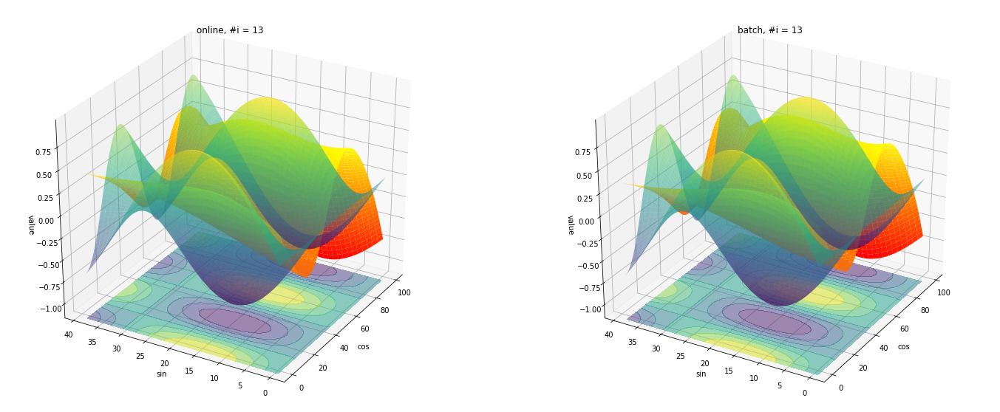

#i =  14
r2_online = 0.61
r2_batch = 0.65
r2_online = 0.61
r2_batch = 0.65


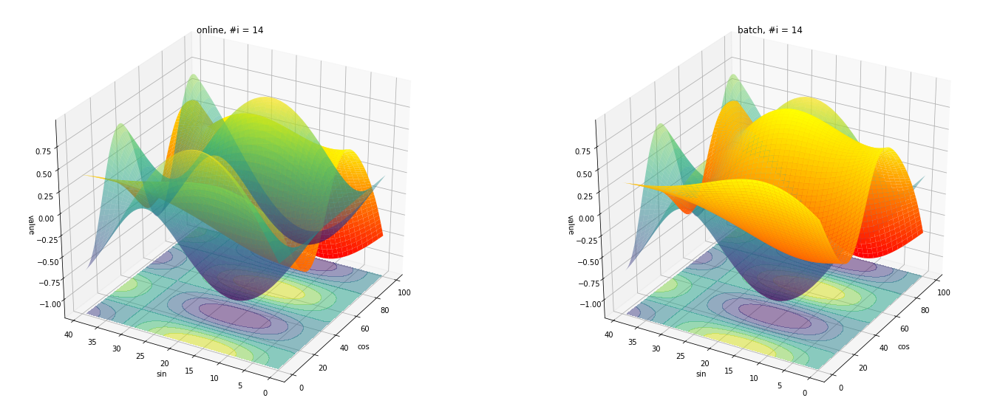

#i =  15
r2_online = 0.67
r2_batch = 0.71
r2_online = 0.67
r2_batch = 0.71


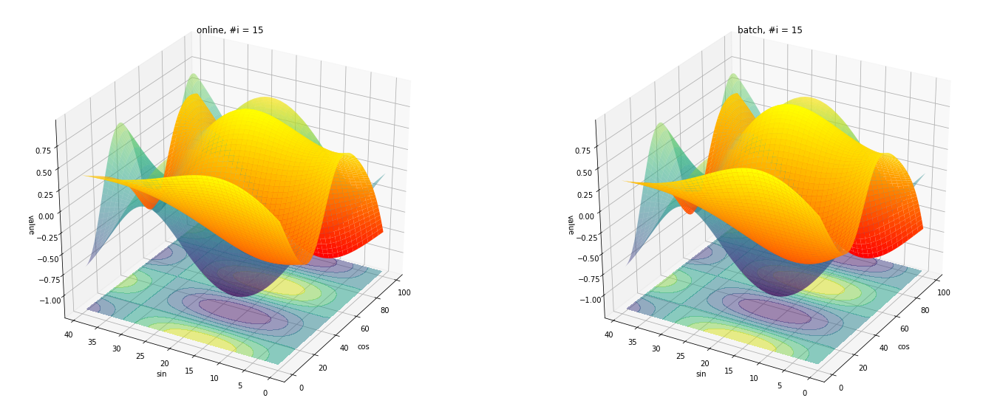

#i =  16
r2_online = 0.73
r2_batch = 0.76
r2_online = 0.73
r2_batch = 0.76


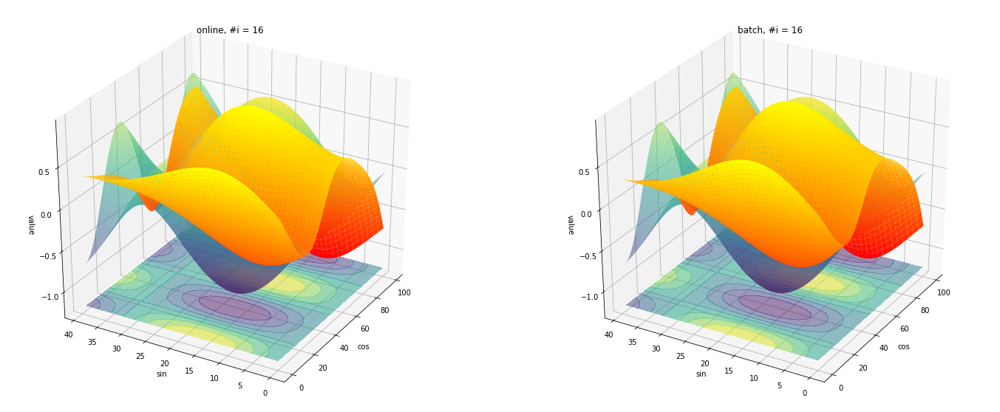

#i =  17
r2_online = 0.78
r2_batch = 0.79
r2_online = 0.78
r2_batch = 0.79


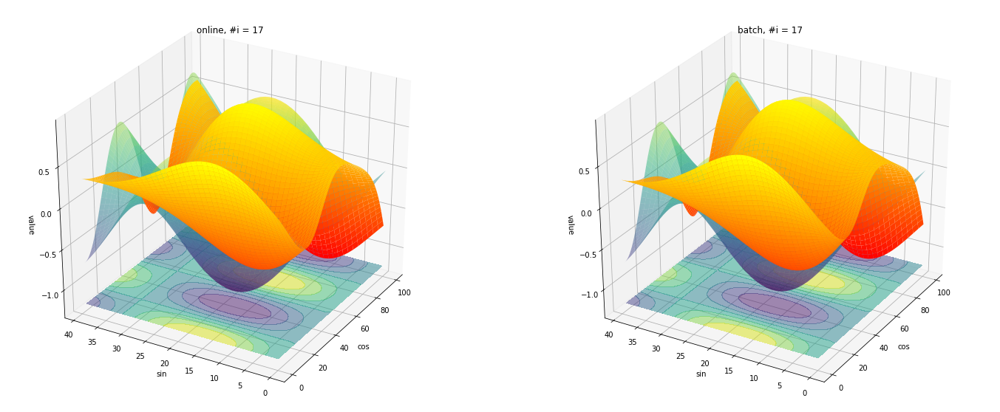

#i =  18
r2_online = 0.82
r2_batch = 0.82
r2_online = 0.82
r2_batch = 0.82


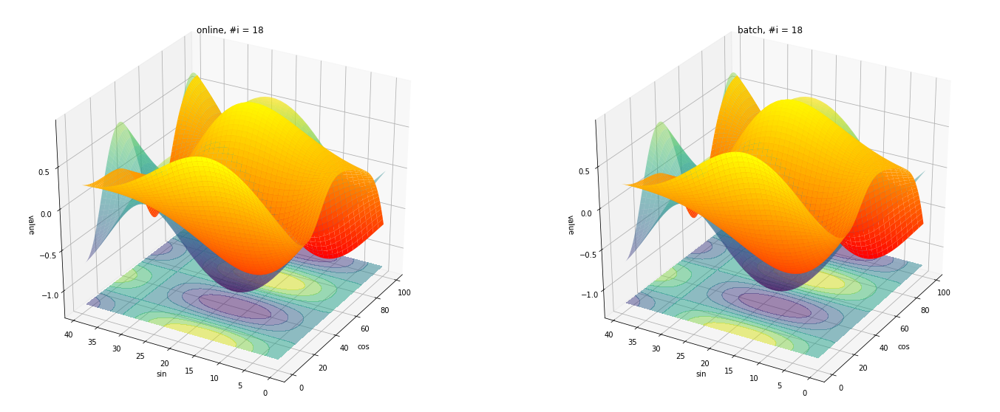

#i =  19
r2_online = 0.86
r2_batch = 0.84
r2_online = 0.86
r2_batch = 0.84


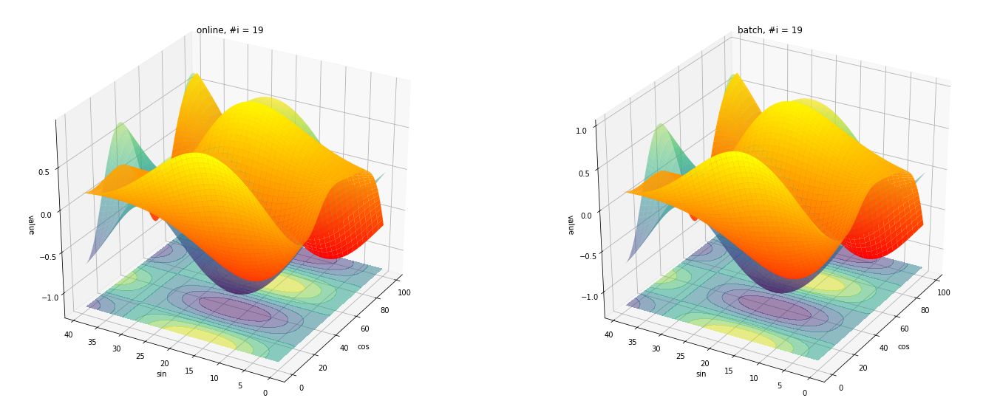

In [173]:
x_scaler = MinMaxScaler(feature_range=(-1,1))
y_scaler = MinMaxScaler(feature_range=(-1,1))

x_scaler.fit(X)
y_scaler.fit(_z.reshape(-1, 1))

X_scaled = x_scaler.transform(X)
y_scaled = y_scaler.transform(_z.reshape(-1, 1))

print('X_scaled.max = ', X_scaled.max())
print('X_scaled.min = ', X_scaled.min())
print('y_scaled.max = ', y_scaled.max())
print('y_scaled.min = ', y_scaled.min())

mlp_online = MLPRegressor(hidden_layer_sizes=(10, ),
                          activation='tanh',
                          solver='sgd',
                          batch_size=32,
                          learning_rate_init=0.05,
                          max_iter=1,                          # mindíg csak 1
                          shuffle=False,
                          random_state=1,
                          warm_start=True,                     # True
                          momentum=0.9,
                          nesterovs_momentum=True,
                          early_stopping=True,
                          n_iter_no_change=2000)



for i in range(0, 20, 1):
  print('#i = ', i)
  if( i != 0 ):

    mlp_batch = MLPRegressor(hidden_layer_sizes=(10, ),
                            activation='tanh',
                            solver='sgd',
                            batch_size=32,
                            learning_rate_init=0.05,
                            max_iter=i,                            # az éppen aktuális ciklusszámláló
                            shuffle=False,
                            random_state=1,
                            warm_start=False,                      # False
                            momentum=0.9,
                            nesterovs_momentum=True,
                            early_stopping=True,
                            n_iter_no_change=2000)


    mlp_online.fit(X_scaled, y_scaled)
    predicted_scaled_online = mlp_online.predict(X_scaled)
    r2_online = r2_score(y_scaled, predicted_scaled_online)
    print('r2_online = {:.2f}'.format(r2_online))

    mlp_batch.fit(X_scaled, y_scaled)
    predicted_scaled_batch = mlp_batch.predict(X_scaled)
    r2_batch = r2_score(y_scaled, predicted_scaled_batch)
    print('r2_batch = {:.2f}'.format(r2_batch))

    predicted_inverted_online = y_scaler.inverse_transform(predicted_scaled_online.reshape(-1, 1))
    r2_online = r2_score(_z, predicted_inverted_online)
    print('r2_online = {:.2f}'.format(r2_online))

    predicted_inverted_batch = y_scaler.inverse_transform(predicted_scaled_batch.reshape(-1, 1))
    r2_batch = r2_score(_z, predicted_inverted_batch)
    print('r2_batch = {:.2f}'.format(r2_batch))

    # a predicted változót vissza kell alakítani mátrix formába
    predicted_z_online = predicted_inverted_online.reshape(z.shape[0], z.shape[1])
    # print(predicted_z_online.shape)

    # a predicted változót vissza kell alakítani mátrix formába
    predicted_z_batch = predicted_inverted_batch.reshape(z.shape[0], z.shape[1])
    # print(predicted_z_batch.shape)


    fig = plt.figure(figsize=(24, 10))
    ax1 = fig.add_subplot(121, projection='3d')
    ax1.set_title('online, #i = ' + str(i))
    ax1.set_xlabel('cos')
    ax1.set_ylabel('sin')
    ax1.set_zlabel('value')
    surf = ax1.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
    surf = ax1.plot_surface(x1, x2, predicted_z_online, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
    cset = ax1.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
    ax1.view_init(30, 210)

    ax2 = fig.add_subplot(122, projection='3d')
    ax2.set_title('batch, #i = ' + str(i))
    ax2.set_xlabel('cos')
    ax2.set_ylabel('sin')
    ax2.set_zlabel('value')
    surf = ax2.plot_surface(x1, x2, z, rstride = 1, cstride = 1, cmap = 'viridis', linewidth = 0.1, antialiased = True, alpha = 0.5)
    surf = ax2.plot_surface(x1, x2, predicted_z_batch, rstride = 1, cstride = 1, cmap = 'autumn', linewidth = 0.4, antialiased = True)
    cset = ax2.contourf(x1, x2, z, zdir = 'z', offset = -1.2, cmap = 'viridis', alpha = 0.5)
    ax2.view_init(30, 210)
    plt.show()



## Online learning - Mit lehet még elrontani

Az egyik lehetséges hiba, ha nem az épen aktuális adathalmazra normáljuk az adatokat.

Fontos, hogy online tanításnál vagy a teljes adatsorra, vagy a még éppen utolsó adatra legyen normálva a tanuló halmaz.

In [ ]:
! rm *.png
! rm *.gif

# mindíg az aktuális értéket normáljuk és nem előre

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one = MinMaxScaler(feature_range=(-1,1))

################################################################################
# A lényeg, hogy nehogy  a forciklusba tegyük a példányosítást, mert akkor
# minden egyes alkalommal újra új példány jön létre és elfelejti a korábbi
# súllyokat amiket megtanult
################################################################################

mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                  activation='tanh',              # tanh, logistic, relu
                  solver='sgd',                   # adam, sgd, lbfgs
                  batch_size='auto',
                  learning_rate_init=0.1,         # Fontos 0.01, 0.02, 0.05, 0.1
                  max_iter=1,                     # Fontos
                  shuffle=False,                  # Fontos
                  random_state=1,
                  warm_start=True,                # Fontos ?
                  momentum=0.9,
                  nesterovs_momentum=False,
                  early_stopping=False,           # Fontos ?
                  verbose=1,
                  n_iter_no_change=1000)


for i in range(0, 500, 1):
  print('#i = ', i)
  if( i > 2 ):

    scaler_x_one.fit(x)
    scaler_y_one.fit(y.reshape(-1,1))
    xs1 = scaler_x_one.transform(x)
    ys1 = scaler_y_one.transform(y.reshape(-1,1))
    print('xs1.min = ', xs1.min())
    print('xs1.max = ', xs1.max())
    print('ys1.min = ', ys1.min())
    print('ys1.max = ', ys1.max())
    print('ys1.shape = ', ys1.shape)
    x_scaled = xs1
    y_scaled = ys1

    x_part = x_scaled[:i,:]
    y_part = y_scaled[:i,:]

    mlp.fit(x_part, y_part)
    predicted = mlp.predict(x_part)
    plt.scatter(x_part, y_part)
    plt.plot(x_part, predicted, c='black')
    plt.title('#i = ' + str(i) + ' r2 = {:.3f}'.format(round(r2,3)) + ' loss = {:.3f}'.format(round(mlp.loss_, 3)))
    plt.ylim((-1.2, 1.2))
    plt.savefig('image{0:03}'.format(i)+'.png')
    plt.show()


from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

## Ugyan ez csak az illeszkedés mértékét is plottolja

## Kívül van normálva

Ami itt érdekes lehet, mi van ha nem egyesévél léptetem a for ciklust, az adatokat? (1, 2, 5, 10)

### ToDo:

Kipróbálni a  ```partial_fit``` methodust a ```fit``` helyett.



In [ ]:
! rm *.png
! rm *.gif


# mindíg az aktuális értéket normáljuk és nem előre

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one = MinMaxScaler(feature_range=(-1,1))

################################################################################
# A lényeg, hogy nehogy  a forciklusba tegyük a példányosítást, mert akkor
# minden egyes alkalommal újra új példány jön létre és elfelejti a korábbi
# súllyokat amiket megtanult
################################################################################

mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                  activation='tanh',              # tanh, logistic, relu
                  solver='sgd',                   # adam, sgd, lbfgs
                  batch_size='auto',
                  learning_rate_init=0.1,         # Fontos 0.01, 0.02, 0.05, 0.1
                  max_iter=1,                     # Fontos
                  shuffle=False,                  # Fontos
                  random_state=1,
                  warm_start=True,                # Fontos ?
                  momentum=0.9,
                  nesterovs_momentum=False,
                  early_stopping=False,           # Fontos ?
                  verbose=1,
                  n_iter_no_change=1000)

r2_history = [0]

for i in range(0, 500, 1):
  print('#i = ', i)
  if( i > 2 ):

    scaler_x_one.fit(x)
    scaler_y_one.fit(y.reshape(-1,1))
    xs1 = scaler_x_one.transform(x)
    ys1 = scaler_y_one.transform(y.reshape(-1,1))
    print('xs1.min = ', xs1.min())
    print('xs1.max = ', xs1.max())
    print('ys1.min = ', ys1.min())
    print('ys1.max = ', ys1.max())
    print('ys1.shape = ', ys1.shape)
    x_scaled = xs1
    y_scaled = ys1

    # ------------------> uff már megin kint van skálázva !!!!!!!!!!!!!!!!!!!!!!

    x_part = x_scaled[:i,:]
    y_part = y_scaled[:i,:]

    mlp.fit(x_part, y_part)
    predicted = mlp.predict(x_part)

    r2 = r2_score(y_part, predicted)
    r2_history.append(r2)

    fig, ax = plt.subplots(1,2, figsize=(15,4), sharey=False)
    ax[0].scatter(x_part, y_part)
    ax[0].plot(x_part, predicted, c='red')
    ax[0].set_ylim((-1.2, 1.2))
    ax[0].set_title('#i = ' + str(i) + ' r2 = {:.3f}'.format(round(r2,3)) + ' loss = {:.3f}'.format(round(mlp.loss_, 3)))
    ax[1].plot(r2_history, c='black')
    ax[1].set_title('r2 = {:.3f}'.format(round(r2,3)))
    ax[1].set_ylim((0, 1.1))
    plt.savefig('image{0:03}'.format(i)+'.png')
    plt.show()
    plt.close()



from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

## Ugyan ez csak az illeszkedés mértékét is plottolja

## Belül van normálva

Ami itt érdekes lehet, mi van ha nem egyesévél léptetem a for ciklust, az adatokat? (1, 2, 5, 10)

In [84]:
! rm *.png
! rm *.gif


# mindíg az aktuális értéket normáljuk és nem előre

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one = MinMaxScaler(feature_range=(-1,1))

################################################################################
# A lényeg, hogy nehogy  a forciklusba tegyük a példányosítást, mert akkor
# minden egyes alkalommal újra új példány jön létre és elfelejti a korábbi
# súllyokat amiket megtanult
################################################################################

mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                  activation='tanh',              # tanh, logistic, relu
                  solver='sgd',                   # adam, sgd, lbfgs
                  batch_size='auto',
                  learning_rate_init=0.1,         # Fontos 0.01, 0.02, 0.05, 0.1
                  max_iter=1,                     # Fontos
                  shuffle=False,                  # Fontos
                  random_state=1,
                  warm_start=True,                # Fontos ?
                  momentum=0.9,
                  nesterovs_momentum=False,
                  early_stopping=False,           # Fontos ?
                  verbose=1,
                  n_iter_no_change=1000)

r2_history = [0]

for i in range(0, 500, 1):
  print('#i = ', i)
  if( i > 2 ):

    # ------------------> most már bent van skálázva !!!!!!!!!!!!!!!!!!!!!!!!!!!

    print(x.shape)
    print(y.shape)

    x_part = x[:i,:]
    y_part = y[:i]

    scaler_x_one.fit(x_part)
    scaler_y_one.fit(y_part.reshape(-1,1))
    xs1 = scaler_x_one.transform(x_part)
    ys1 = scaler_y_one.transform(y_part.reshape(-1,1))
    print('xs1.min = ', xs1.min())
    print('xs1.max = ', xs1.max())
    print('ys1.min = ', ys1.min())
    print('ys1.max = ', ys1.max())
    print('ys1.shape = ', ys1.shape)
    x_scaled = xs1
    y_scaled = ys1


    mlp.fit(x_scaled, y_scaled)
    predicted = mlp.predict(x_scaled)

    r2 = r2_score(y_scaled, predicted)
    r2_history.append(r2)

    fig, ax = plt.subplots(1,2, figsize=(15,4), sharey=False)
    ax[0].scatter(x_scaled, y_scaled)
    ax[0].plot(x_scaled, predicted, c='red')
    ax[0].set_ylim((-1.2, 1.2))
    ax[0].set_title('#i = ' + str(i) + ' r2 = {:.3f}'.format(round(r2,3)) + ' loss = {:.3f}'.format(round(mlp.loss_, 3)))
    ax[1].plot(r2_history, c='black')
    ax[1].set_title('r2 = {:.3f}'.format(round(r2,3)))
    ax[1].set_ylim((0, 1.1))
    plt.savefig('image{0:03}'.format(i)+'.png')
    plt.show()
    plt.close()



from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

rm: cannot remove '*.gif': No such file or directory
#i =  0
#i =  1
#i =  2
#i =  3
(40, 100)
(40, 100)
xs1.min =  -1.0
xs1.max =  -1.0
ys1.min =  -1.0
ys1.max =  1.0
ys1.shape =  (300, 1)


ValueError: ignored

## Néhány hasznos Scikit learn metodus

Amit a későbbiek folyamán még szeretnék felhasználni

In [ ]:
mlp.best_loss_

In [ ]:
mlp.loss

In [ ]:
mlp.loss_

In [ ]:
mlp.loss_curve_

In [ ]:
mlp.partial_fit

In [ ]:
plt.plot(mlp.loss_curve_)

## Van egy úgynevezett zseniális ötletem

Az merült ma fel bennem, hogy mi lenne akkor ha online módszerrel folyamatosan<br>
tanítanánk a neurális hálót, de nem csak egyet, hanem rögtön többet is<br>
különböző learning rate-tel.<br>

Ennek az a lényege, hogy a tanulás egyes pontjain a magasabb learning rate<br>
miatt néha 'ugrik' egyet a becslés az egyel korábbihoz képest és lehet,<br>
hogy egy másik learning rate-tel tanított háló 'abszolút hibája' vagy<br>
'négyzetes hibája' alapján közelebb áll a becslése a valós értékehez<br>
ezért mindíg azt választjuk ki egy adott időpontban amelyik becslése<br>
pontosabb eredményt ad.<br>

Ilyen módon a 'hiper paramétert' is menet közben választjuk ki<br>

Van ennek egyébként egy tágabbb elméleti megfontolása is<br>

Mivel incrementált vagyis online tanításról van szó mehet közben<br>
meggondolhatjuk magunkat és fenn áll annak a lehetősége, hogy<br>
másik hiperparaméterrel kellett volna tanítani a hálót.<br>
Csakhogy ezen menet közben már nem lehet változtatni ezért azt csinálom<br>
hogy egyszerre több neurális hálót kezdek el tanítani különböző<br>
hiperparaméterekkel és mindíg azt választom amelyik jobb becslést ad.<br>

Egy picit olyan post-hoc hipotézis vizsgálathoz hasonlít ez mint, ha<br>
azt mondom, hogy az volt a feltételezésem, hogy de kiderült, hogy.<br>

Tehát élünk annak a lehetőségével, hogy módosítsunk egy korábbi feltételezésünkön<br>
ami még mindíg jobb mintha ragaszkodnánk ahhoz, amiről már tudjuk, hogy rossz.

In [ ]:
! rm *.png
! rm *.gif


# mindíg az aktuális értéket normáljuk és nem előre

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one = MinMaxScaler(feature_range=(-1,1))

################################################################################
# A lényeg, hogy nehogy  a forciklusba tegyük a példányosítást, mert akkor
# minden egyes alkalommal újra új példány jön létre és elfelejti a korábbi
# súllyokat amiket megtanult
################################################################################

mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                  activation='tanh',              # tanh, logistic, relu
                  solver='sgd',                   # adam, sgd, lbfgs
                  batch_size='auto',
                  learning_rate_init=0.1,         # Fontos 0.01, 0.02, 0.05, 0.1
                  max_iter=1,                     # Fontos
                  shuffle=False,                  # Fontos
                  random_state=1,
                  warm_start=True,                # Fontos ?
                  momentum=0.9,
                  nesterovs_momentum=False,
                  early_stopping=False,           # Fontos ?
                  verbose=1,
                  n_iter_no_change=1000)

r2_history = [0]

for i in range(0, 500, 1):
  print('#i = ', i)
  if( i > 2 ):

    x_part = x[:i,:]
    y_part = y[:i]

    scaler_x_one.fit(x_part)
    scaler_y_one.fit(y_part.reshape(-1,1))
    xs1 = scaler_x_one.transform(x_part)
    ys1 = scaler_y_one.transform(y_part.reshape(-1,1))
    x_scaled = xs1
    y_scaled = ys1

    x_scaled = scaler_x_one.fit_transform(x_part)
    y_scaled = scaler_y_one.fit_transform(y_part.reshape(-1,1)).reshape(-1,1)



    mlp.fit(x_scaled, y_scaled)
    predicted = mlp.predict(x_scaled)

    r2 = r2_score(y_scaled, predicted)
    r2_history.append(r2)

    fig, ax = plt.subplots(1,2, figsize=(15,4), sharey=False)
    ax[0].scatter(x_scaled, y_scaled)
    ax[0].plot(x_scaled, predicted, c='red')
    ax[0].set_ylim((-1.2, 1.2))
    ax[0].set_title('#i = ' + str(i) + ' r2 = {:.3f}'.format(round(r2,3)) + ' loss = {:.3f}'.format(round(mlp.loss_, 3)))
    ax[1].plot(r2_history, c='black')
    ax[1].set_title('r2 = {:.3f}'.format(round(r2,3)))
    ax[1].set_ylim((0, 1.1))
    plt.savefig('image{0:03}'.format(i)+'.png')
    plt.show()
    plt.close()



from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

## ToDo

Két dolgot kéne itt kipróbálni

(A) az MLPRegressorn belül az iterációk számál lehet játszani

(B) a for ciklus lépésközeivel lehet játszani


(C) természetesen a learning ratetel is lehet játszani


(D) és a zseniális ötletemet sem szabad elvetni, hogy egyszerre több modelt tanítunk és minden egyes lépésben azt választjuk amelyik a legjobb eredményt adja éppen akkor

(E) ki szeretném próbálni azt is, hogy a partial_fit metodust hívom úgy, hogy
az összes adatot odaadom neki, 1 iteráció van megengedve, de ezt meghívom 2000-szer és megnézem, hogy azonos eredményt adott-e mintha a sima fit() metodust hívom 2000 max_iter paraméterrel (természetesen a folyamatot is monitorozni kell és összehasonlítani)

(F) !

Illetve van még egy olyan kísérlet, hogy a partial_fit, vagy a fit() hívásakor csak az új adatot adom neki oda és nem a megnövelt adatot (!) van különgég. Az egyik esetben csak egy adatot kap, a második esetben mindig n + 1 adatot.



## ToDo (E)

ki szeretném próbálni azt is, hogy a partial_fit metodust hívom úgy, hogy az összes adatot odaadom neki, 1 iteráció van megengedve, de ezt meghívom 2000-szer és megnézem, hogy azonos eredményt adott-e mintha a sima fit() metodust hívom 2000 max_iter paraméterrel (természetesen a folyamatot is monitorozni kell és összehasonlítani)

Tehát a lényeg, hogy
- mindíg megkapja az összes adatot
- de egyszerre csak egy iterációt csinál
- viszont ezt úgy, hogy nem felejt -> incremental learning
- végül összehasonlítaom azzal, ha a max_iter = 2000

x_scaled.shape =  (600, 1)
y_scaled.shape =  (600, 1)
x_scaled.min   =  -1.0
x_scaled.max   =  1.0
y_scaled.min   =  -1.0
y_scaled.max   =  1.0


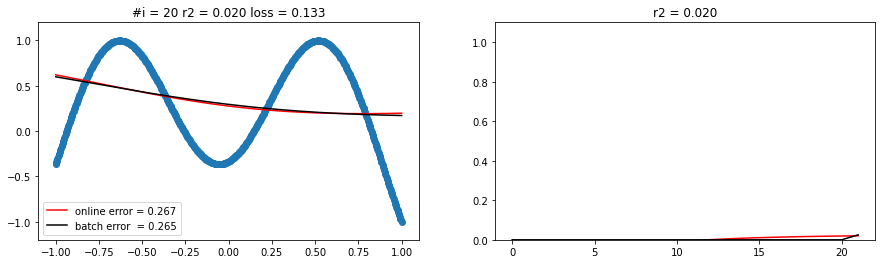

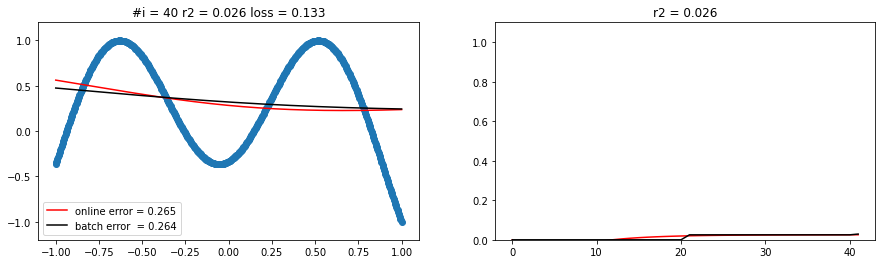

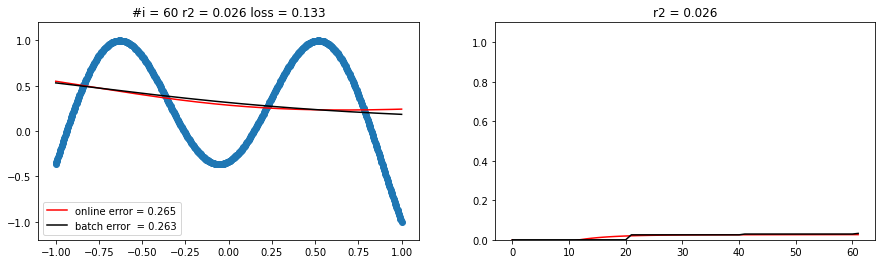

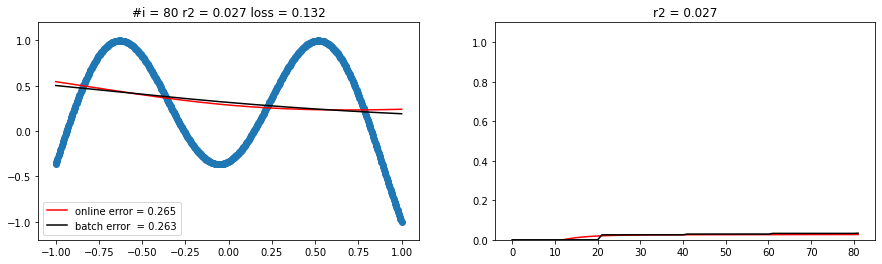

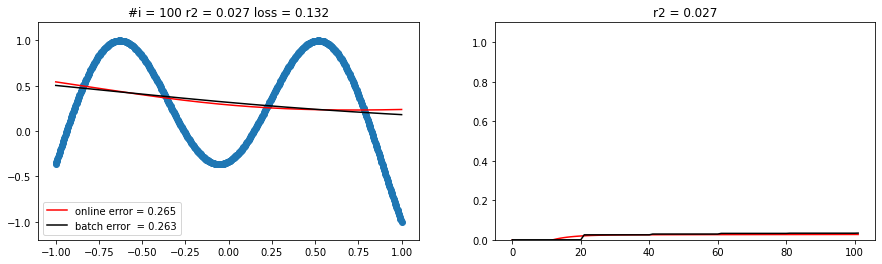

...

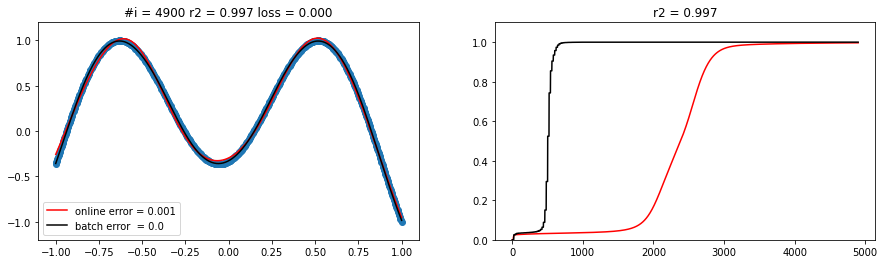

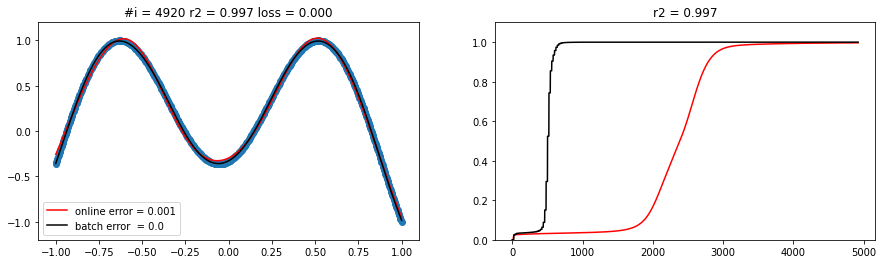

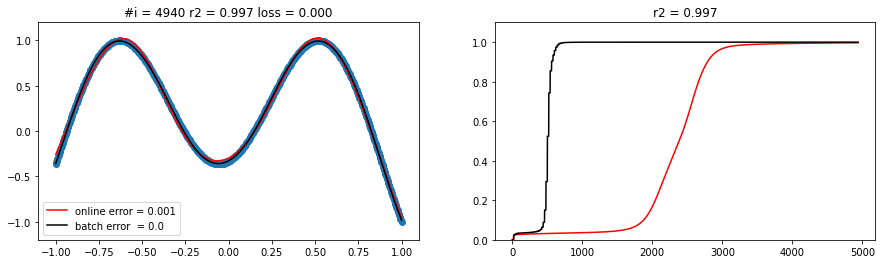

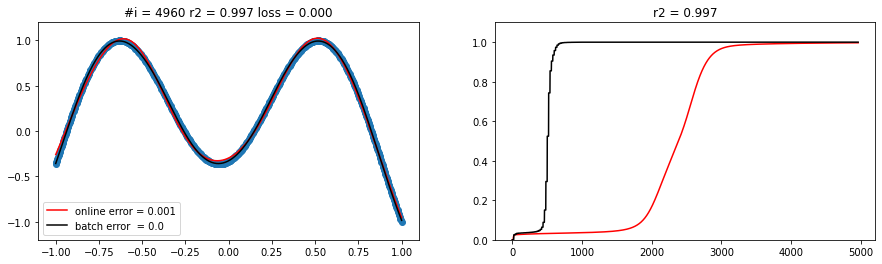

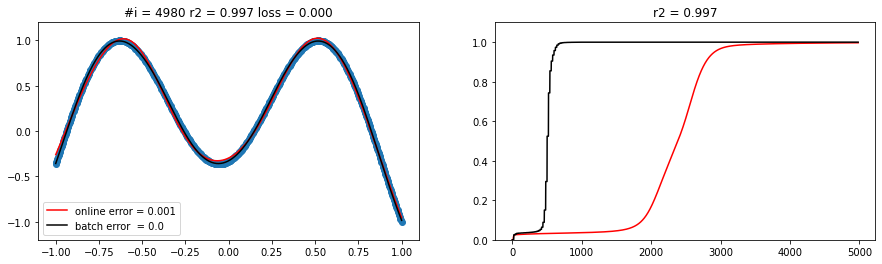

In [ ]:
! rm *.png
! rm *.gif


# Paraméterek

batch_size          = x.size            # 'auto'
solver              = 'sgd'        # adam, sgd, lbfgs
shuffle             = False
learning_rate_init  = 0.1



# Mivel minden adatot odadunk ezért egy lépésben normalizálhatjuk az egészet

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one = MinMaxScaler(feature_range=(-1,1))

x_scaled = scaler_x_one.fit_transform(x)
y_scaled = scaler_y_one.fit_transform(y.reshape(-1,1)).reshape(-1,1)

print('x_scaled.shape = ', x_scaled.shape)
print('y_scaled.shape = ', y_scaled.shape)
print('x_scaled.min   = ', x_scaled.min())
print('x_scaled.max   = ', x_scaled.max())
print('y_scaled.min   = ', y_scaled.min())
print('y_scaled.max   = ', y_scaled.max())

################################################################################
# A lényeg, hogy nehogy  a forciklusba tegyük a példányosítást, mert akkor
# minden egyes alkalommal újra új példány jön létre és elfelejti a korábbi
# súllyokat amiket megtanult
################################################################################

mlp_online = MLPRegressor(hidden_layer_sizes=(10, 5),
                          activation='tanh',              # tanh, logistic, relu
                          solver=solver,                   # adam, sgd, lbfgs
                          batch_size=batch_size,
                          learning_rate_init=learning_rate_init,         # Fontos 0.01, 0.02, 0.05, 0.1
                          max_iter=1,                     # Mindíg csak egy iterációt végzünk el
                          shuffle=shuffle,                  # Fontos
                          random_state=1,
                          warm_start=True,                # Fontos
                          momentum=0.9,
                          nesterovs_momentum=False,
                          early_stopping=False,           # Fontos
                          verbose=0,
                          n_iter_no_change=1000)

r2_online_history = [0]
r2_batch_history  = [0]
r2_batch          =  0

for i in range(0, 5000, 1):
  # print('#i = ', i)

  mlp_online.fit(x_scaled, y_scaled)
  predicted_online = mlp_online.predict(x_scaled)

  r2_online = r2_score(y_scaled, predicted_online)
  r2_online_history.append(r2_online)

  error_online = mean_squared_error(y_scaled, predicted_online)

  if( i % 20 == 0 and i > 0 ):

    # Néhány lépésenként nézzük meg, hogy milyen eredményt ad neurális háló
    # ha batchben tanítjuk. Ez a háló mindíg újra tanul, és max_iter = i
    # számú lépést fog végrehajtani

    mlp_batch  = MLPRegressor(hidden_layer_sizes=(10, 5),
                              activation='tanh',              # tanh, logistic, relu
                              solver=solver,                   # adam, sgd, lbfgs
                              batch_size=batch_size,
                              learning_rate_init=learning_rate_init,         # Fontos 0.01, 0.02, 0.05, 0.1
                              max_iter=i,                     # Az iterációk számát itt a for ciklusból kapjuk
                              shuffle=shuffle,                  # Fontos
                              random_state=1,
                              warm_start=False,               # Fontos
                              momentum=0.9,
                              nesterovs_momentum=False,
                              early_stopping=False,
                              verbose=0,
                              n_iter_no_change=1000)
    
    mlp_batch.fit(x_scaled, y_scaled)
    predicted_batch = mlp_batch.predict(x_scaled)

    error_batch = mean_squared_error(y_scaled, predicted_batch)

    r2_batch = r2_score(y_scaled, predicted_batch)
    r2_batch_history.append(r2_batch)


    # Plottoljuk ki az eredményeket

    fig, ax = plt.subplots(1,2, figsize=(15,4), sharey=False)
    ax[0].scatter(x_scaled, y_scaled)
    ax[0].plot(x_scaled, predicted_online, c='red', label='online error = ' + str(round(error_online, 3)))
    ax[0].plot(x_scaled, predicted_batch, c='black', label='batch error  = ' + str(round(error_batch, 3)))
    ax[0].set_ylim((-1.2, 1.2))
    ax[0].set_title('#i = ' + str(i) + ' r2 = {:.3f}'.format(round(r2_online,3)) + ' loss = {:.3f}'.format(round(mlp_online.loss_, 3)))
    ax[1].plot(r2_online_history, c='red')
    ax[1].plot(r2_batch_history, c='black')
    ax[1].set_title('r2 = {:.3f}'.format(round(r2_online,3)))
    ax[1].set_ylim((0, 1.1))
    ax[0].legend(loc=3)
    plt.savefig('image{0:04}'.format(i)+'.png')
    plt.show()
    plt.close()

  else:
    r2_batch_history.append(r2_batch)


# Fűzzük össze a képeket

from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

In [ ]:
MLPRegressor()

# Create images

Ezt csak érdeksségnek raktam ide, kétféle képen ábrázolja a hiba (helyesebben) az r2 alakulását.

In [ ]:
! rm *.png
! rm *.gif

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_x_one.fit(x)
xs1 = scaler_x_one.transform(x)
scaler_y_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one.fit(y.reshape(-1,1))
ys1 = scaler_y_one.transform(y.reshape(-1,1))
print('xs1.min = ', xs1.min())
print('xs1.max = ', xs1.max())
print('ys1.min = ', ys1.min())
print('ys1.max = ', ys1.max())
print('ys1.shape = ', ys1.shape)
x_scaled = xs1
y_scaled = ys1

r2_history = [0]

for i in range(0, 150, 1):
  print('#i = ', i)
  if( i != 0 ):
    mlp = MLPRegressor(hidden_layer_sizes=(30, 15),
                      activation='tanh', 
                      solver='adam',
                      batch_size='auto',
                      learning_rate_init=0.01,
                      max_iter=i,
                      shuffle=True,
                      random_state=1,
                      momentum=0.9,
                      nesterovs_momentum=True,
                      early_stopping=True,
                      n_iter_no_change=2000)

    mlp.fit(x_scaled, y_scaled)
    predicted = mlp.predict(x_scaled)

    r2 = r2_score(y_scaled, predicted)
    r2_history.append(r2)

    fig, ax = plt.subplots(1,2, figsize=(15,4), sharey=False)
    ax[0].scatter(x_scaled, y_scaled)
    ax[0].plot(x_scaled, predicted, c='red')
    ax[0].set_ylim((-1.2, 1.2))
    ax[0].set_title('#i = ' + str(i))
    ax[1].plot(r2_history, c='black')
    ax[1].set_title('r2 = {:.3f}'.format(round(r2,3)))
    ax[1].set_ylim((0, 1.1))
    plt.savefig('image{0:03}'.format(i)+'.png')
    plt.show()
    plt.close()

from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

# Create images

Ezt csak érdeksségnek raktam ide, kétféle képen ábrázolja az r2 alakulását futó ablakban.

In [ ]:
! rm *.png
! rm *.gif

scaler_x_one = MinMaxScaler(feature_range=(-1,1))
scaler_x_one.fit(x)
xs1 = scaler_x_one.transform(x)
scaler_y_one = MinMaxScaler(feature_range=(-1,1))
scaler_y_one.fit(y.reshape(-1,1))
ys1 = scaler_y_one.transform(y.reshape(-1,1))
print('xs1.min = ', xs1.min())
print('xs1.max = ', xs1.max())
print('ys1.min = ', ys1.min())
print('ys1.max = ', ys1.max())
print('ys1.shape = ', ys1.shape)
x_scaled = xs1
y_scaled = ys1

r2_history = [0]


n = 150
for i in range(0, n, 1):
  print('#i = ', i)
  if( i != 0 ):
    mlp = MLPRegressor(hidden_layer_sizes=(30, 15),
                      activation='tanh', 
                      solver='adam',
                      batch_size='auto',
                      learning_rate_init=0.01,
                      max_iter=i,
                      shuffle=True,
                      random_state=1,
                      momentum=0.9,
                      nesterovs_momentum=True,
                      early_stopping=True,
                      n_iter_no_change=2000)

    mlp.fit(x_scaled, y_scaled)
    predicted = mlp.predict(x_scaled)

    r2 = r2_score(y_scaled, predicted)
    r2_history.append(r2)

    fig, ax = plt.subplots(1,2, figsize=(15,4), sharey=False)
    ax[0].scatter(x_scaled, y_scaled)
    ax[0].plot(x_scaled, predicted, c='red')
    ax[0].set_ylim((-1.2, 1.2))
    ax[0].set_title('#i = ' + str(i))
    ax[1].plot(r2_history, c='black')
    ax[1].set_title('r2 = {:.3f}'.format(round(r2,3)))
    ax[1].set_ylim((0, 1.1))
    ax[1].set_xlim((0, n))
    plt.savefig('image{0:03}'.format(i)+'.png')
    plt.show()
    plt.close()

from PIL import Image
import glob

frames = []
imgs = glob.glob("*.png")
imgs.sort()
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

frames[0].save('animation.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=100, loop=0)

## Kisegítő olvasmányok

Watermark extention
<br>
https://github.com/rasbt/watermark#installation-and-updating